In [1]:
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.preprocessing import scale

plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False


In [2]:
df_raw = pd.read_excel('../附件1：赛题A数据.xlsx')
print(df_raw.info())

df = df_raw
df['时间'] = 0
df = (df - df.min()) / (df.max() - df.min())    # 归一化


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40368 entries, 0 to 40367
Data columns (total 73 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Unnamed: 0                             40368 non-null  int64  
 1   时间                                     40368 non-null  object 
 2   基站编号                                   40368 non-null  int64  
 3   小区编号                                   40368 non-null  int64  
 4   本地小区标识                                 40368 non-null  int64  
 5   上行可用的PRB个数                             40368 non-null  int64  
 6   下行可用的PRB个数                             40368 non-null  int64  
 7   上行PhysicalResourceBlock被使用的平均个数        40368 non-null  float64
 8   下行PhysicalResourceBlock被使用的平均个数        40368 non-null  float64
 9   上行PUSCH的PhysicalResourceBlock被使用的平均个数  40368 non-null  float64
 10  小区内的平均用户数                              40368 non-null  float64
 11  小区

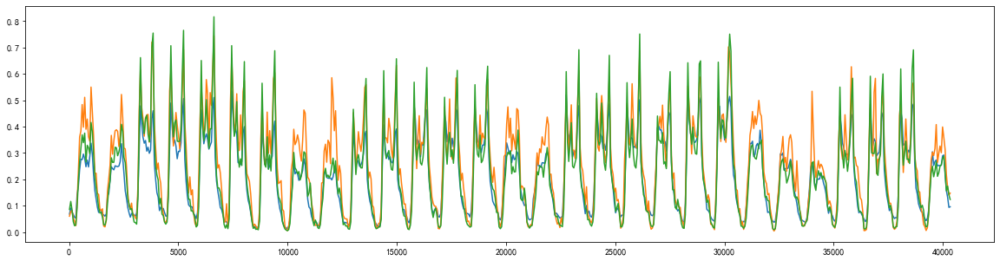

In [12]:
df['PDCP_total'] = df['小区PDCP层所接收到的上行数据的总吞吐量比特'].add(
    df['小区PDCP层所发送的下行数据的总吞吐量比特'])
cells = df['小区编号'].unique()


# MIN = 58
# offset = 5
# span = 10
# TIME_STAMP = list(range(offset*MIN, (offset+span)*MIN, 1)) # df.shape[0]


def switchToCell(cellNum):  # 小区号
    global df_raw
    cells = df_raw['小区编号'].unique()
    TIME_STAMP = list(df_raw[df_raw['小区编号'] == cells[cellNum]].index)
    return TIME_STAMP

def draw(cellInfo):
    time_stamp = cellInfo.index
    fig = plt.figure(figsize=(20, 5))
    ax1 = fig.add_subplot()
    ax1.plot(time_stamp, cellInfo.iloc[:, 0], label=cellInfo.columns[0])
    ax1.plot(time_stamp, cellInfo.iloc[:, 1], label=cellInfo.columns[1])
    ax1.plot(time_stamp, cellInfo.iloc[:, 2], label=cellInfo.columns[2])
    plt.show()

time_stamp = switchToCell(20)
df1_detect = df.loc[time_stamp, ['小区内的平均用户数', 'PDCP_total', '平均激活用户数']]
draw(df1_detect)


# 第一题

## MK趋势预测

E:\Anaconda\envs\rbu\lib\site-packages\ipykernel_launcher.py:57: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "m--" (-> color='m'). The keyword argument will take precedence.
E:\Anaconda\envs\rbu\lib\site-packages\ipykernel_launcher.py:59: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "m--" (-> color='m'). The keyword argument will take precedence.


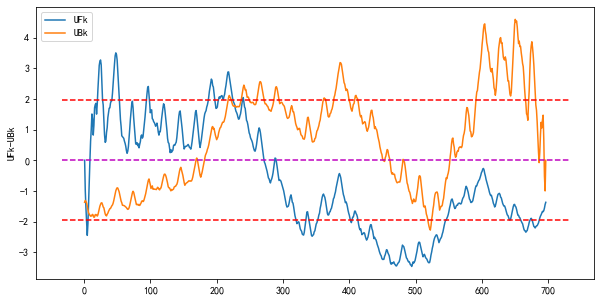

In [5]:
def Kendall_change_point_detection(inputdata):
    inputdata = np.array(inputdata)
    n = inputdata.shape[0]
    Sk = [0]
    UFk = [0]
    s = 0
    Exp_value = [0]
    Var_value = [0]
    for i in range(1, n):
        for j in range(i):
            if inputdata[i] > inputdata[j]:
                s = s+1
            else:
                s = s+0
        Sk.append(s)
        Exp_value.append((i+1)*i/4)                     # Sk[i]的均值
        Var_value.append((i+1)*i*(2*(i+1)+5)/72)            # Sk[i]的方差
        UFk.append((Sk[i]-Exp_value[i])/np.sqrt(Var_value[i]))

    Sk2 = [0]
    # 定义逆序统计量UBk，长度与inputdata一致，初始值=0
    UBk = [0]
    UBk2 = [0]
    # s归0
    s2 = 0
    Exp_value2 = [0]
    Var_value2 = [0]
    # 按时间序列逆转样本y
    inputdataT = list(reversed(inputdata))
    # i从2开始，因为根据统计量UBk公式，i=1时，Sk2(1)、E(1)、Var(1)均为0
    # 此时UBk无意义，因此公式中，令UBk(1)=0
    for i in range(1, n):
        for j in range(i):
            if inputdataT[i] > inputdataT[j]:
                s2 = s2+1
            else:
                s2 = s2+0
        Sk2.append(s2)
        Exp_value2.append((i+1)*i/4)                     # Sk[i]的均值
        Var_value2.append((i+1)*i*(2*(i+1)+5)/72)            # Sk[i]的方差
        UBk.append((Sk2[i]-Exp_value2[i])/np.sqrt(Var_value2[i]))
        UBk2.append(-UBk[i])
    UBkT = list(reversed(UBk2))
    diff = np.array(UFk) - np.array(UBkT)
    K = list()
    # 找出交叉点
    for k in range(1, n):
        if diff[k-1]*diff[k] < 0:
            K.append(k)
            
    # 做突变检测图时，使用UFk和UBkT
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, n+1), UFk, label='UFk')  # UFk
    plt.plot(range(1, n+1), UBkT, label='UBk')  # UBk
    plt.ylabel('UFk-UBk')
    x_lim = plt.xlim()
    plt.plot(x_lim, [-1.96, -1.96], 'm--', color='r')
    plt.plot(x_lim, [0,  0], 'm--')
    plt.plot(x_lim, [+1.96, +1.96], 'm--', color='r')
    plt.legend(loc=2)  # 图例
    plt.show()


Kendall_change_point_detection(df1_detect['PDCP_total'])


## 箱型图

E:\Anaconda\envs\rbu\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


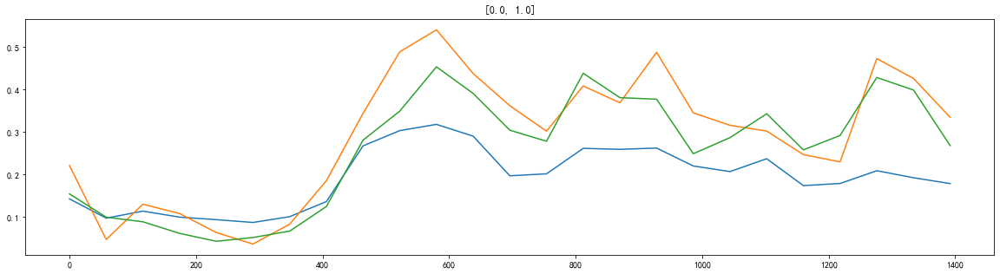

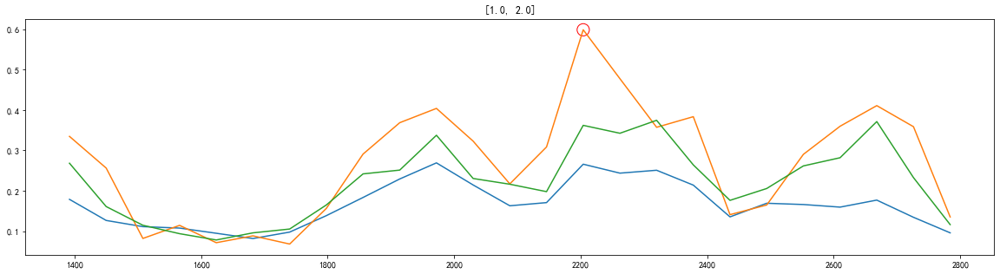

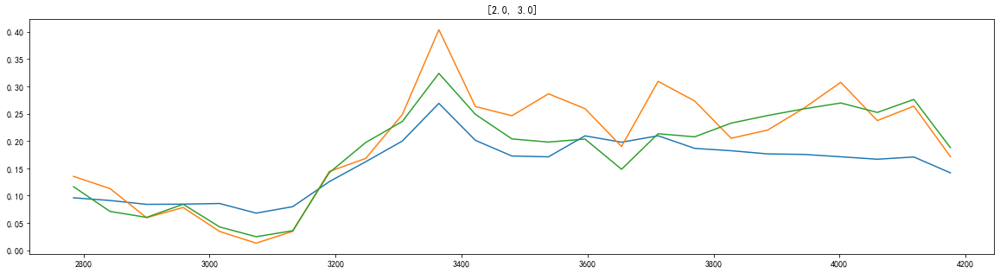

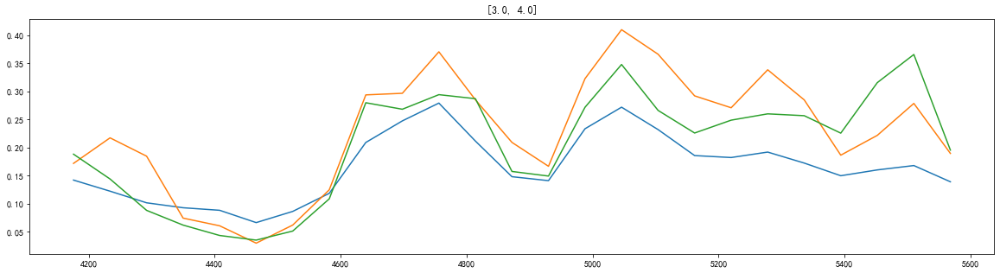

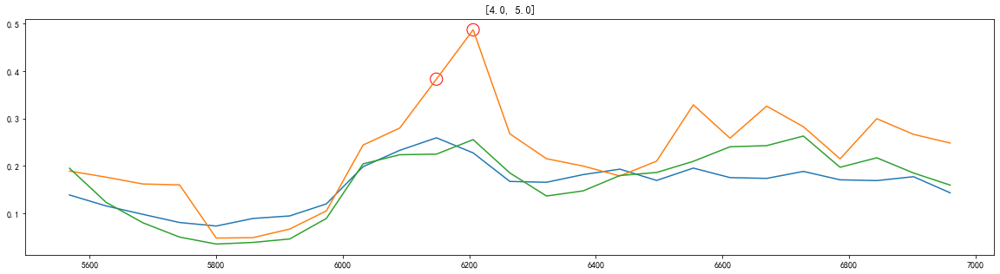

...

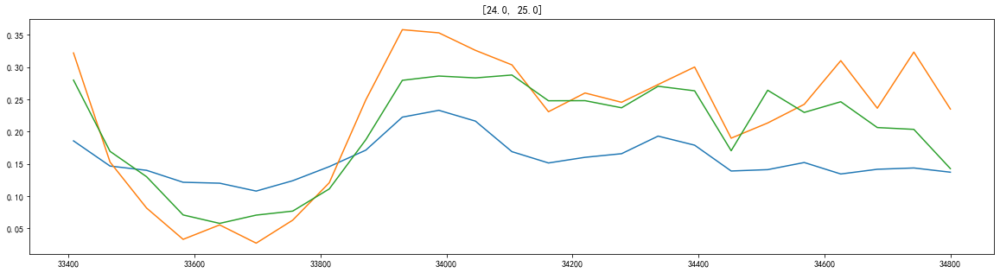

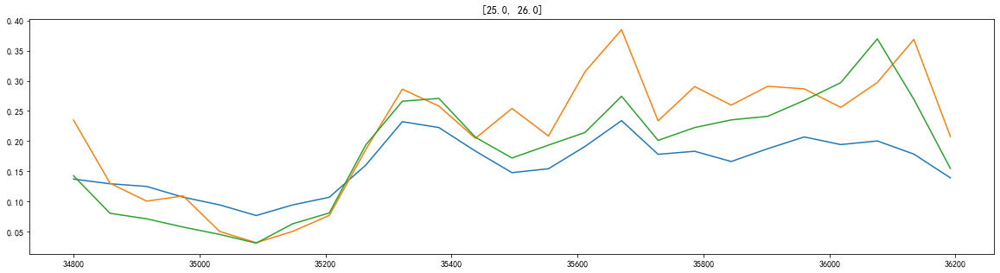

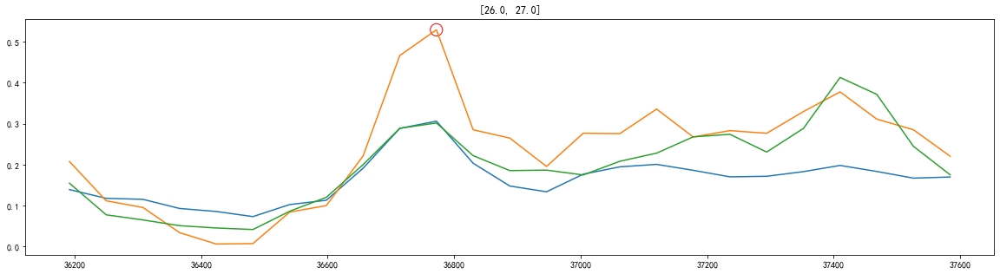

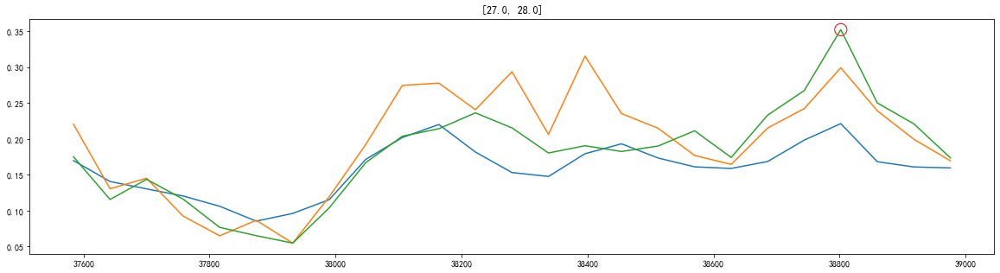

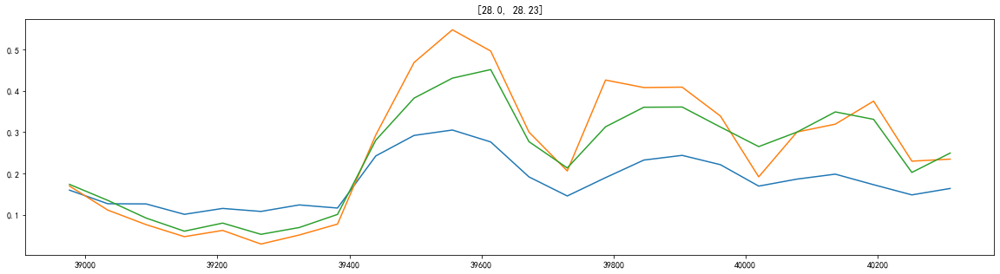

In [38]:
def boxDetect(_df, plot=True):
    _df = pd.DataFrame(_df)

    k = pd.Series([], dtype=pd.StringDtype())
    columns = _df.columns
    for column in columns:
        k = pd.concat([k, _df.loc[:, column]])
    
    D = k.describe()
    Q3 = D['75%'] + 1.5*(D['75%'] - D['25%'])
    Q1 = D['25%'] - 1.5*(D['75%'] - D['25%'])
    # print(Q3, Q1)

    if plot:
        plt.figure(figsize=(20, 5))
        if _df.shape[1] > 1:
            k = _df[columns[0]][_df[columns[0]] > Q3]
            plt.plot(_df.index, _df[columns[0]].values, label='PDCP_total')
            plt.scatter(k.index, k, color='none', edgecolors='r', s=200, marker='o')

            k = _df[columns[1]][_df[columns[1]] > Q3]
            plt.plot(_df.index, _df[columns[1]].values, label='PDCP_total')
            plt.scatter(k.index, k, color='none', edgecolors='r', s=200, marker='o')
            
            k = _df[columns[2]][_df[columns[2]] > Q3]
            plt.plot(_df.index, _df[columns[2]].values, label='PDCP_total')
            plt.scatter(k.index, k, color='none', edgecolors='r', s=200, marker='o')
        else:
            k = _df[_df > Q3]
            plt.plot(_df.index, _df, label='PDCP_total')
            plt.scatter(k.index, k, color='none', edgecolors='r', s=200, marker='o')
        head, tail = _df.index[0]//58, _df.index[-1]//58
        hh, th, ht, tt = head//24, tail//24, head%24, tail%24
        plt.title([hh+0.01*ht, th+0.01*tt])
    return Q3

def scrollToTime(df, start, end):
    TIME_STAMP = df.index
    end = end * 58
    start = start * 58
    ans = []
    for i in TIME_STAMP:
        if i > end: break
        if i >= start:
            ans.append(i)
    return ans


# boxDetect(PDCP_total)
# boxDetect(avg_users)
# boxDetect(avg_activate_users)
cet = ['label_小区内的平均用户数', 'label_PDCP_total', 'label_平均激活用户数']

def sliding(df, start, rounds, plot=False):
    span = 24

    df['label'] = None
    for r in range(rounds):
        time_stamp = scrollToTime(df, start + r*span, start + (r+1)*span)
        df2 = df.loc[time_stamp, ['小区内的平均用户数', 'PDCP_total', '平均激活用户数']]
        Q3 = boxDetect(df2, True)
        for i in range(3):
            idx = df2[df2.iloc[:, i]>Q3].index
            df.loc[idx, cet[i]] = 1
    df = df.fillna(0)
    return df


for i in range(1):
    time_stamp = switchToCell(i)

    df1_detect = df.loc[time_stamp, ['小区内的平均用户数', 'PDCP_total', '平均激活用户数']]
    df1_detect = sliding(df1_detect, 0, 29, plot=True)  # 29
    idx = df1_detect.index
    df.loc[idx, cet] = df1_detect[cet]

### 制作标签

In [24]:
print(df.loc[:, cet])
# df[cet].to_csv('Q1.csv')

       label_小区内的平均用户数  label_PDCP_total  label_平均激活用户数
0                  0.0               0.0            0.0
1                  0.0               0.0            0.0
2                  0.0               0.0            0.0
3                  0.0               0.0            0.0
4                  0.0               0.0            0.0
...                ...               ...            ...
40363              0.0               0.0            0.0
40364              0.0               0.0            0.0
40365              0.0               0.0            0.0
40366              0.0               0.0            0.0
40367              0.0               0.0            0.0

[40368 rows x 3 columns]


## LOF检测

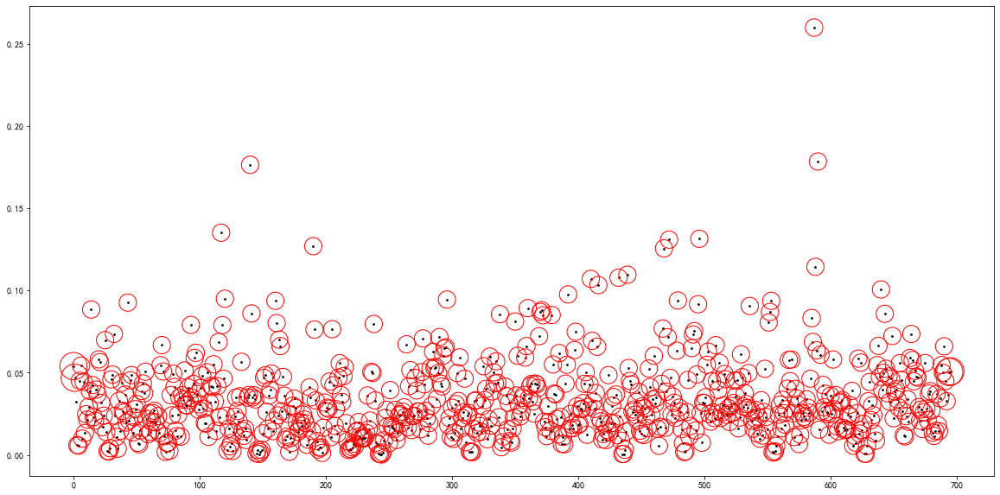

In [19]:
from sklearn.neighbors import LocalOutlierFactor

X = np.array(list(enumerate(df1_detect['PDCP_total'])))

clf = LocalOutlierFactor(n_neighbors=2) # TODO
clf.fit_predict(X)
X_scores = clf.negative_outlier_factor_

fig = plt.figure(figsize=(20, 10))
plt.scatter(X[:, 0], X[:, 1], color='k', s=3, label='data points')
radius = (X_scores.max() - X_scores) / (X_scores.max() - X_scores.min())
plt.scatter(
    X[:, 0], 
    X[:, 1],
    color='none', 
    edgecolors='r', 
    s=radius*1000, 
    label='data points'
)


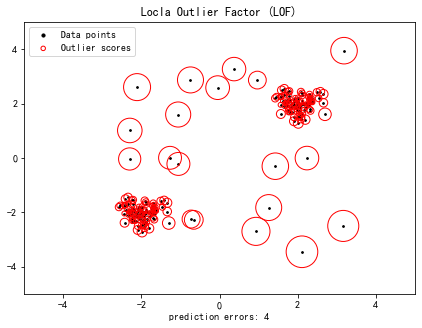

In [37]:
import numpy as np
from sklearn.neighbors import LocalOutlierFactor as LOF
import matplotlib.pyplot as plt
 
# generate train data
X_inliers = 0.3 * np.random.randn(100, 2)
X_inliers = np.r_[X_inliers + 2, X_inliers - 2]
 
 
# generate some outliers
X_outliers = np.random.uniform(low=-4, high=4, size=(20, 2))
X = np.r_[X_inliers, X_outliers]
 
n_outliers = len(X_outliers)  # 20
ground_truth = np.ones(len(X), dtype=int)
ground_truth[-n_outliers:] = -1
 
# fit the model for outlier detection
clf = LOF(n_neighbors=20, contamination=0.1)
 
# use fit_predict to compute the predicted labels of the training samples
y_pred = clf.fit_predict(X)
n_errors = (y_pred != ground_truth).sum()
X_scores = clf.negative_outlier_factor_
 
 
plt.figure(figsize=(7, 5))
plt.title('Locla Outlier Factor (LOF)')
plt.scatter(X[:, 0], X[:, 1], color='k', s=3., label='Data points')
# plot circles with radius proportional to thr outlier scores
radius = (X_scores.max() - X_scores) / (X_scores.max() - X_scores.min())
plt.scatter(X[:, 0], X[:, 1], s=1000*radius, edgecolors='r',
    facecolors='none', label='Outlier scores')
plt.axis('tight')
plt.xlim((-5, 5))
plt.ylim((-5, 5))
plt.xlabel("prediction errors: %d"%(n_errors))
legend = plt.legend(loc='upper left')
legend.legendHandles[0]._sizes = [10]
legend.legendHandles[1]._sizes = [20]
plt.show()

# 第二题

In [19]:
import joblib

df2 = df.loc[:, ['PDCP_total', '小区内的平均用户数', '平均激活用户数', 'label']]
TIME_STAMP = switchToCell(15)
df2_predict = df2.loc[TIME_STAMP, :]
# draw(df2_predict)


def train_split(df, ipt_size, opt_size, stepping, test_size=0.3):
    
    dim = df.shape[1]-1
    split_line = df.shape[0] * (1-test_size)
    x_train = np.array([])
    y_train = np.array([])
    x_test = np.array([])
    y_test = np.array([])
    cursor_x = 0
    cursor_y = cursor_x + ipt_size
    while cursor_y + opt_size <= df.shape[0]:
        x = []
        for i in range(ipt_size):
            x.extend(df.iloc[cursor_x+i, :dim].to_list())

        y = []
        flag = 0
        for i in range(opt_size):
            flag = flag | int(df.iloc[cursor_y+i, dim])
        y.append(flag)

        if cursor_y <= split_line:
            x_train = np.append(x_train, x, axis=0)
            y_train = np.append(y_train, y, axis=0)
        else:
            x_test = np.append(x_test, x, axis=0)
            y_test = np.append(y_test, y, axis=0)
        cursor_x += stepping
        cursor_y += stepping
    
    x_train = x_train.reshape(-1, dim*ipt_size)
    x_test = x_test.reshape(-1, dim*ipt_size)
    return x_train, y_train, x_test, y_test

def make_dataset(df, ipt_size, opt_size, stepping, test_size=0.3):
    dim = df.shape[1]-1
    x_train = np.empty([0, ipt_size*dim])
    y_train = np.array([])
    x_test = np.empty([0, ipt_size*dim])
    y_test = np.array([])
    for i in range(58):
        time_stamp = switchToCell(i)
        _df = df.loc[time_stamp, :]

        k1, k2, k3, k4 = train_split(
            _df, ipt_size, opt_size, stepping, test_size=0
        )
        if i <= 58*(1-test_size):
            x_train = np.append(x_train, k1, axis=0)
            y_train = np.append(y_train, k2, axis=0)
        else:
            x_test = np.append(x_test, k1, axis=0)
            y_test = np.append(y_test, k2, axis=0)
        print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)
        
    return x_train, y_train, x_test, y_test

print(df2_predict)
x_train, y_train, x_test, y_test = make_dataset(df2, 24, 6, 6)

       PDCP_total  小区内的平均用户数   平均激活用户数  label
15       0.180792   0.150379  0.137333    0.0
73       0.074399   0.124671  0.088589    0.0
131      0.059386   0.109246  0.050267    0.0
189      0.018940   0.078823  0.025208    0.0
247      0.017894   0.079459  0.024942    0.0
...           ...        ...       ...    ...
40093    0.083701   0.139736  0.113775    0.0
40151    0.133895   0.155864  0.130535    0.0
40209    0.224141   0.179932  0.132729    1.0
40267    0.358457   0.215940  0.217024    1.0
40325    0.195506   0.184531  0.103288    0.0

[696 rows x 4 columns]
(112, 72) (112,) (0, 72) (0,)
(224, 72) (224,) (0, 72) (0,)
(336, 72) (336,) (0, 72) (0,)
(448, 72) (448,) (0, 72) (0,)
(560, 72) (560,) (0, 72) (0,)
(672, 72) (672,) (0, 72) (0,)
(784, 72) (784,) (0, 72) (0,)
(896, 72) (896,) (0, 72) (0,)
(1008, 72) (1008,) (0, 72) (0,)
(1120, 72) (1120,) (0, 72) (0,)
(1232, 72) (1232,) (0, 72) (0,)
(1344, 72) (1344,) (0, 72) (0,)
(1456, 72) (1456,) (0, 72) (0,)
(1568, 72) (1568,) (0, 7

In [101]:
print(metrics.SCORERS.keys())
print(sum(y_train))

dict_keys(['explained_variance', 'r2', 'max_error', 'neg_median_absolute_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_root_mean_squared_error', 'neg_mean_poisson_deviance', 'neg_mean_gamma_deviance', 'accuracy', 'top_k_accuracy', 'roc_auc', 'roc_auc_ovr', 'roc_auc_ovo', 'roc_auc_ovr_weighted', 'roc_auc_ovo_weighted', 'balanced_accuracy', 'average_precision', 'neg_log_loss', 'neg_brier_score', 'adjusted_rand_score', 'rand_score', 'homogeneity_score', 'completeness_score', 'v_measure_score', 'mutual_info_score', 'adjusted_mutual_info_score', 'normalized_mutual_info_score', 'fowlkes_mallows_score', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_wei

In [5]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

import joblib
from sklearn import metrics
from sklearn.gaussian_process.kernels import RBF, ConstantKernel
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LinearRegression

from sklearn.model_selection import train_test_split, KFold
import warnings

warnings.filterwarnings('ignore')


RANDOM_STATE = 10

kernel_gpc = ConstantKernel(1.0, (1e-3, 1e3)) * RBF(10, (0.5, 2))
models = [
    GaussianProcessClassifier(kernel_gpc, random_state=RANDOM_STATE), 
    RandomForestClassifier(random_state=RANDOM_STATE), 
    SVC(random_state=RANDOM_STATE, probability=True),
    GradientBoostingClassifier(random_state=RANDOM_STATE)
]

params = [
    {
        'n_restarts_optimizer': range(10), 
    }, {
        'n_estimators': range(10, 151, 10),
        'max_depth': range(2, 6), 
    }, {
        'C': np.linspace(0.2, 2, 10), 
        'gamma': ['scale', 'auto', 0.5, 1, 1.5, 2, 2.5, 3],
    }, {
        'n_estimators': range(5, 150, 5), 
        'learning_rate': np.linspace(0.1, 3, 30), 
        'max_depth': range(1, 5)
    }
]


for gen, data in enumerate(dataset):

    x_train, y_train, x_test, y_test = data[0], data[1], data[2], data[3]
    print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

    kf = KFold(n_splits=4)
    v_pred = np.zeros([x_train.shape[0],2])
    x_pred = np.zeros([x_test.shape[0],2])
    for i, (v1, v2) in enumerate(kf.split(x_train, y_train)):
        # print('model {}'.format(i).center(100, '-'))
        grid = RandomizedSearchCV(models[i], params[i], scoring='f1', n_iter=200, n_jobs=-1, cv=4)
        grid.fit(x_train[v1], y_train[v1])
        clf = grid.best_estimator_

        v_pred[v2] = clf.predict_proba(x_train[v2])
        x_pred += clf.predict_proba(x_test) / kf.n_splits


    clf2 = RandomForestClassifier()
    clf2.fit(v_pred, y_train)
    y_pred = clf2.predict(x_pred)
    print('generation {} F1 score:{}'.format(gen, metrics.f1_score(y_test, y_pred)).center(100, '-'))
    joblib.dump(clf2, 'stacking{}.model'.format(gen))



print('OVER'.center(100, '*'))
print('OVER'.center(100, '*'))
print('OVER'.center(100, '*'))
# print(v_pred)
# print(y_pred)



(4592, 54)
(4592,)
(1904, 54)
(1904,)
[0. 0. 0. ... 0. 0. 1.]


E:\Anaconda\envs\rbu\lib\site-packages\sklearn\model_selection\_search.py:296: UserWarning: The total space of parameters 10 is smaller than n_iter=300. Running 10 iterations. For exhaustive searches, use GridSearchCV.
  UserWarning,


In [ ]:
clf_ = RandomForestClassifier(n_estimators=2, max_depth=2)
clf_.fit(v_pred, y_train)
pred = clf_.predict(y_pred)


print(metrics.f1_score(pred, y_test))

In [ ]:
plt.scatter(v_pred[0], v_pred[1])
plt.show()

# 第三问

In [1]:
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
df3 = pd.read_excel('../附件1：赛题A数据.xlsx')
df3['PDCP_total'] = df3['小区PDCP层所接收到的上行数据的总吞吐量比特'].add(
    df3['小区PDCP层所发送的下行数据的总吞吐量比特'])
print(df3)


       Unnamed: 0                时间     基站编号      小区编号  本地小区标识  上行可用的PRB个数  \
0               0  2021-08-28 00:00  1200071  26019014       0         100   
1               1  2021-08-28 00:00  1200071  26019015       1         100   
2               2  2021-08-28 00:00  1200071  26019016       2         100   
3               3  2021-08-28 00:00  1200071  26019023       3         100   
4               4  2021-08-28 00:00  1200071  26019024       4         100   
...           ...               ...      ...       ...     ...         ...   
40363       40363  2021-09-25 23:00  1200075  26019033       7         100   
40364       40364  2021-09-25 23:00  1200075  26019034       8         100   
40365       40365  2021-09-25 23:00  1200075  26019035       9         100   
40366       40366  2021-09-25 23:00  1200075  26019027      10         100   
40367       40367  2021-09-25 23:00  1200075  26019028      11         100   

       下行可用的PRB个数  上行PhysicalResourceBlock被使用的平均个数  \
0        

In [ ]:
import torch
from torch import nn
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

columns_3 = ['时间', '小区编号', '基站编号', '小区内的平均用户数', 'PDCP_total', '平均激活用户数']
features = columns_3[-3:]

df3_ = df3.loc[:, columns_3]  # 使用单个小区的数据
df3_[features] = df3_.loc[:, features].apply(lambda x: (x - np.min(x)) / (np.max(x) - np.min(x)))   # 归一化


ipt_size = 1 * 24 * 6   # 输入行数 = 1*小时*天
opt_size = 1 * 24 * 3    # 输出行数
ipt_size = int(ipt_size)
opt_size = int(opt_size)
c = 0
x = np.empty([0,3])
y = np.empty([0,3])
pk = df3_[features].to_numpy()
while c+ipt_size+opt_size <= pk.shape[0]:
    x = np.append(x, pk[c:c+ipt_size, :], axis=0)
    y = np.append(y, pk[c+ipt_size:c+ipt_size+opt_size, :], axis=0)
    c += opt_size
    
x = x.reshape(-1, ipt_size, 3)
y = y.reshape(-1, opt_size*3)

print(x.shape, y.shape)

div = int(x.shape[0]*(1-0.3))   # 训练集比例
x_train = torch.tensor(x[:div]).float().reshape(-1, ipt_size, 3).to(device)
y_train = torch.tensor(y[:div]).float().reshape(-1, opt_size * 3).to(device)

x_test = torch.tensor(x[div:]).float().reshape(-1, ipt_size, 3).to(device)
y_test = torch.tensor(y[div:]).float().reshape(-1, opt_size * 3).to(device)
print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)



### 制作数据集

In [2]:
import torch
from torch import nn

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

ipt_size = 1 * 24 * 6   # 输入行数 = 1*小时*天
opt_size = 1 * 24 * 3   # 输出行数

cells = df3['小区编号'].unique()


def switchToCell(cellNum, df_raw):  # 小区号
    cells = df_raw['小区编号'].unique()
    TIME_STAMP = list(df_raw[df_raw['小区编号'] == cells[cellNum]].index)
    return TIME_STAMP

def make_dataset3(df, step=None, test=False):

    columns_3 = ['时间', '小区编号', '基站编号', '小区内的平均用户数', 'PDCP_total', '平均激活用户数']
    features = columns_3[-3:]

    df3_ = df.loc[:, columns_3]

    df3_[features] = df3_[features].apply(lambda x: (x - np.min(x)) / (np.max(x) - np.min(x)))   # 归一化

    x = np.empty([0,3])
    y = np.empty([0,3])

    pk = df3_[features].to_numpy()
    edge = ipt_size+opt_size
    if not test:
        c = 0
    else:
        c = pk.shape[0]%opt_size
    # print(pk.shape[0])
    while c+edge <= pk.shape[0]:
        x = np.append(x, pk[c:c+ipt_size, :], axis=0)
        y = np.append(y, pk[c+ipt_size:c+ipt_size+opt_size, :], axis=0)
        if step:
            c += step
        else:
            c += opt_size
    x = x.reshape(-1, ipt_size, 3)
    y = y.reshape(-1, opt_size*3)

    if test:
        train = torch.tensor(x).float().reshape(-1, ipt_size, 3).to(device)
        label = torch.tensor(y).float().reshape(-1, opt_size*3).to(device)
        return train, label

    div = int(x.shape[0]*(1-0.3))   # 训练集比例
    x_train = torch.tensor(x[:div]).float().reshape(-1, ipt_size, 3).to(device)
    y_train = torch.tensor(y[:div]).float().reshape(-1, opt_size * 3).to(device)

    x_test = torch.tensor(x[div:]).float().reshape(-1, ipt_size, 3).to(device)
    y_test = torch.tensor(y[div:]).float().reshape(-1, opt_size * 3).to(device)
    # print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

    return x_train, y_train, x_test, y_test, pk


cells = df3['小区编号'].unique()
for cell in cells:
    df_ = df3[df3['小区编号']==cell]
    train, test = make_dataset3(df_, test=True)


### 训练

loss:0.00020977266831323504  test_loss:0.012476438656449318: 100%|██████████| 1800/1800 [00:12<00:00, 147.81it/s]


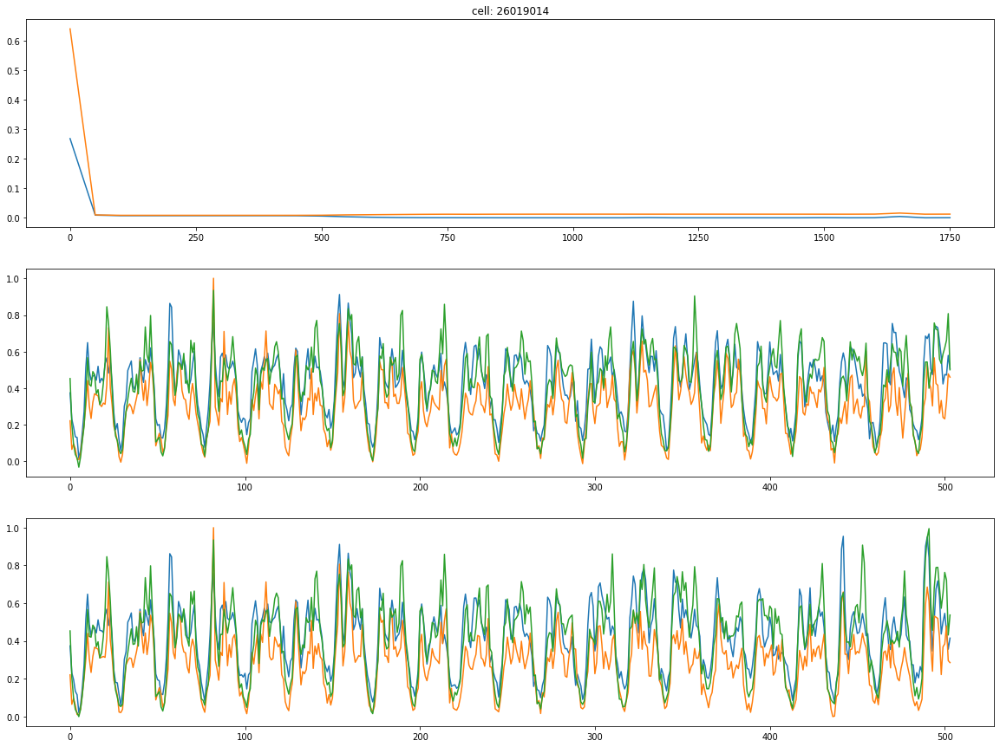

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      0.436192  5.552458e+08     0.050787  2.601903e+07
std       3.468880  4.946120e+09     0.451374  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      44.043412  7.637564e+10     6.679153  2.601906e+07


loss:3.6851783079328015e-05  test_loss:0.01728231832385063: 100%|██████████| 1800/1800 [00:11<00:00, 154.25it/s]


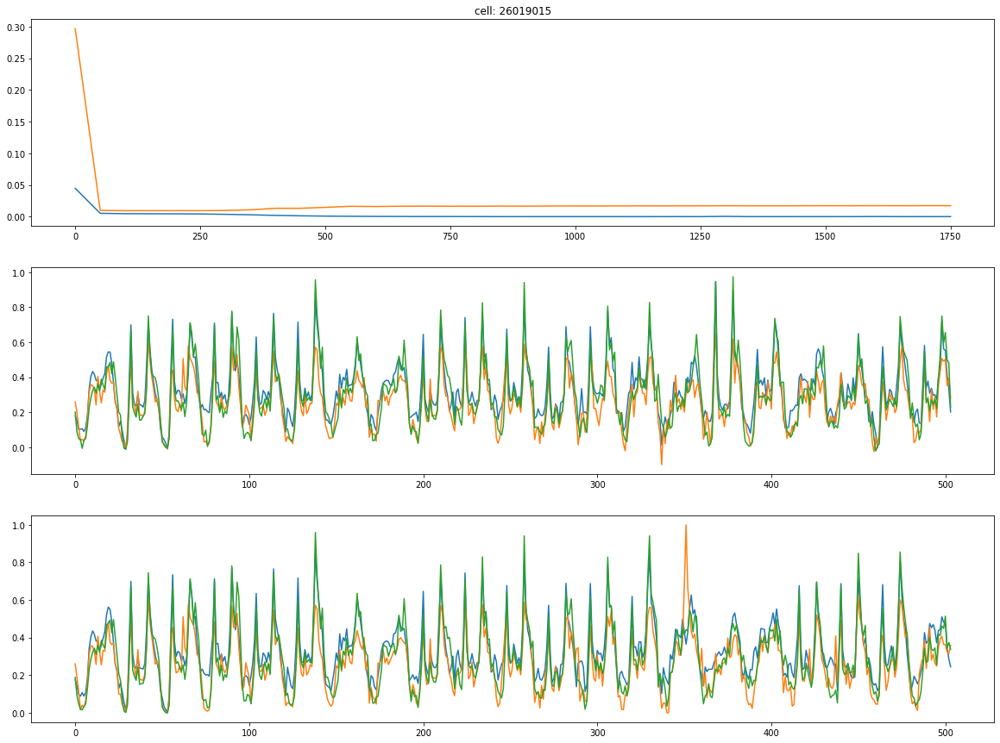

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      0.765204  9.446190e+08     0.098772  2.601903e+07
std       4.344589  5.953462e+09     0.616170  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      44.043412  7.637564e+10     6.821222  2.601906e+07


loss:0.0005059982067905366  test_loss:0.010395157150924206: 100%|██████████| 1800/1800 [00:11<00:00, 155.16it/s]


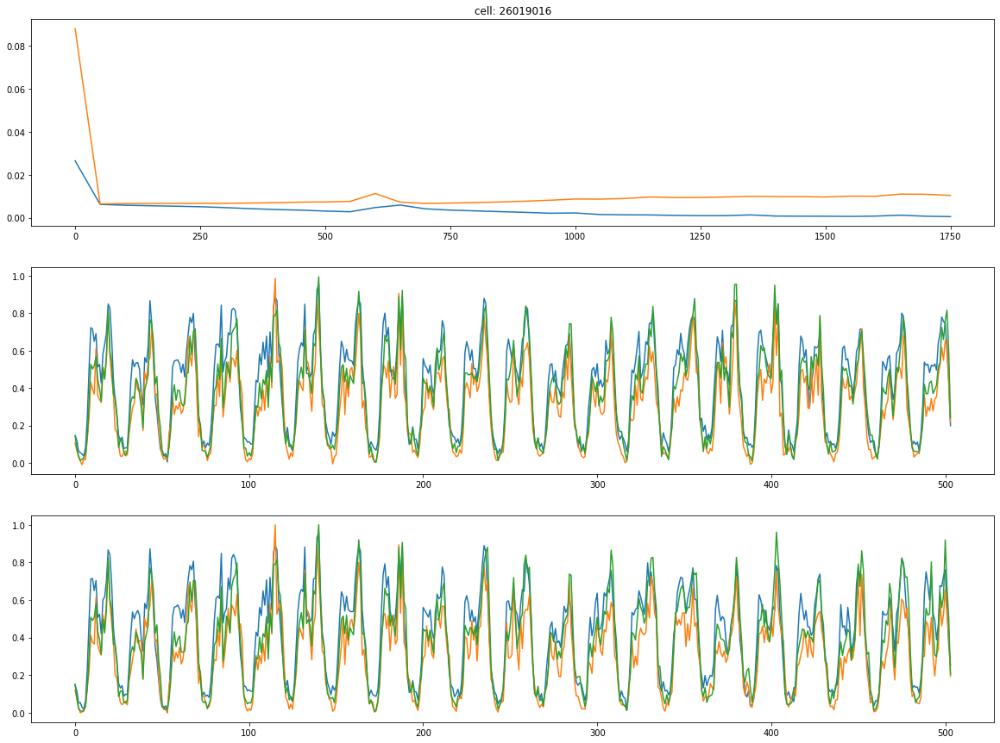

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      1.230177  1.482455e+09     0.148794  2.601903e+07
std       5.774445  7.691230e+09     0.752103  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      52.023730  7.904325e+10     6.821222  2.601906e+07


loss:0.004224528092890978  test_loss:0.008686057291924953: 100%|██████████| 1800/1800 [00:11<00:00, 156.67it/s]


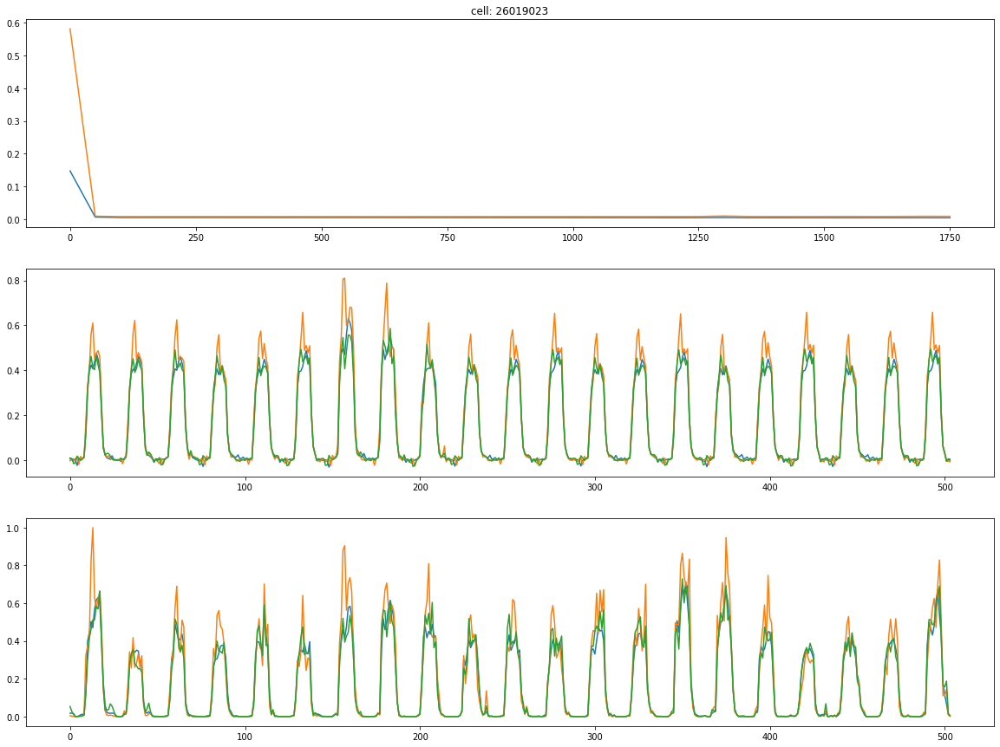

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      1.431041  1.705430e+09     0.167861  2.601903e+07
std       6.164465  8.071607e+09     0.777872  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      52.023730  7.904325e+10     6.821222  2.601906e+07


loss:0.0022681697737425566  test_loss:0.004983255174010992: 100%|██████████| 1800/1800 [00:11<00:00, 153.51it/s]


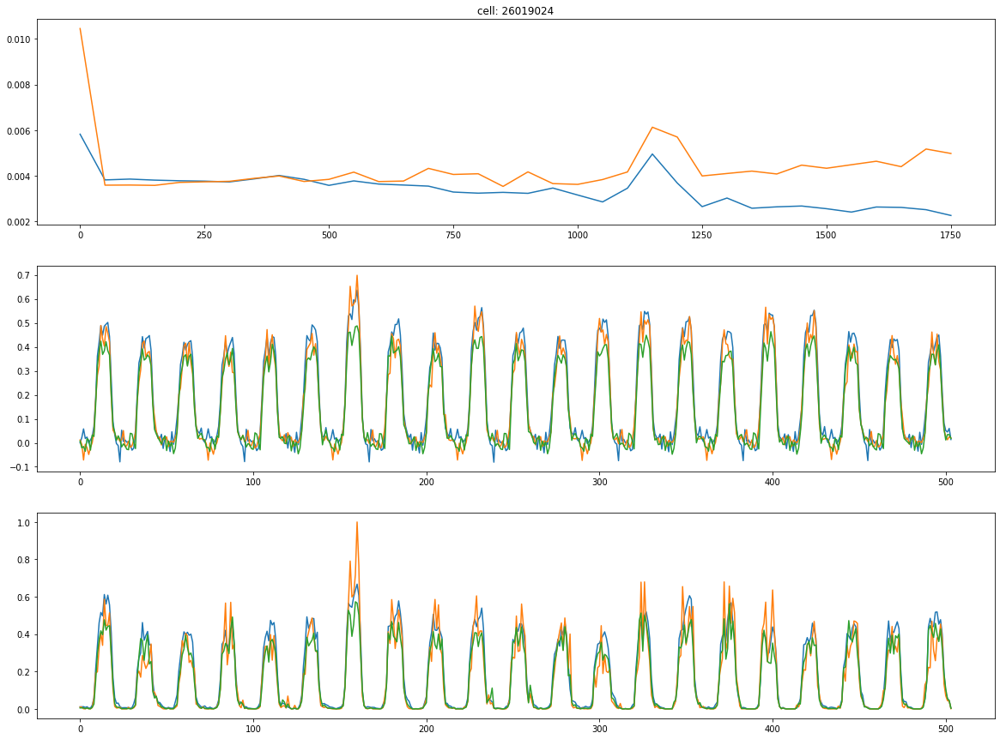

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      1.660100  1.950843e+09     0.189535  2.601903e+07
std       6.619153  8.510572e+09     0.809572  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      52.023730  7.904325e+10     6.821222  2.601906e+07


loss:0.0005892313783988357  test_loss:0.03584926202893257: 100%|██████████| 1800/1800 [00:11<00:00, 151.82it/s]


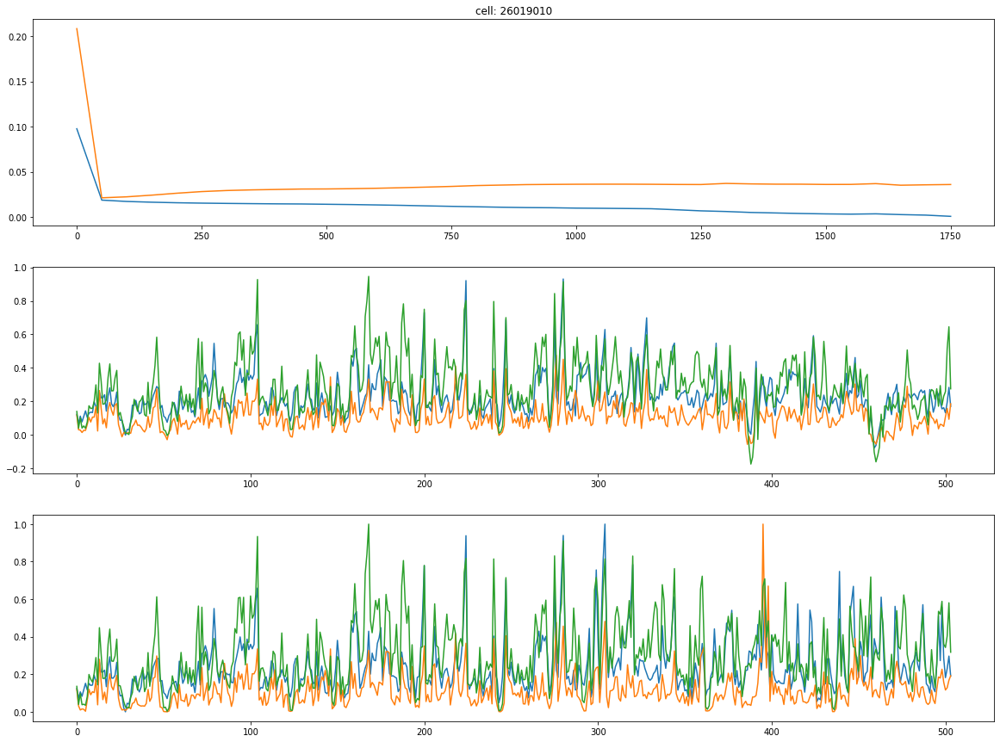

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      1.737910  2.057491e+09     0.198235  2.601903e+07
std       6.629826  8.547433e+09     0.811127  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      52.023730  7.904325e+10     6.821222  2.601906e+07


loss:0.003091393271461129  test_loss:0.011330010369420052: 100%|██████████| 1800/1800 [00:11<00:00, 151.60it/s]


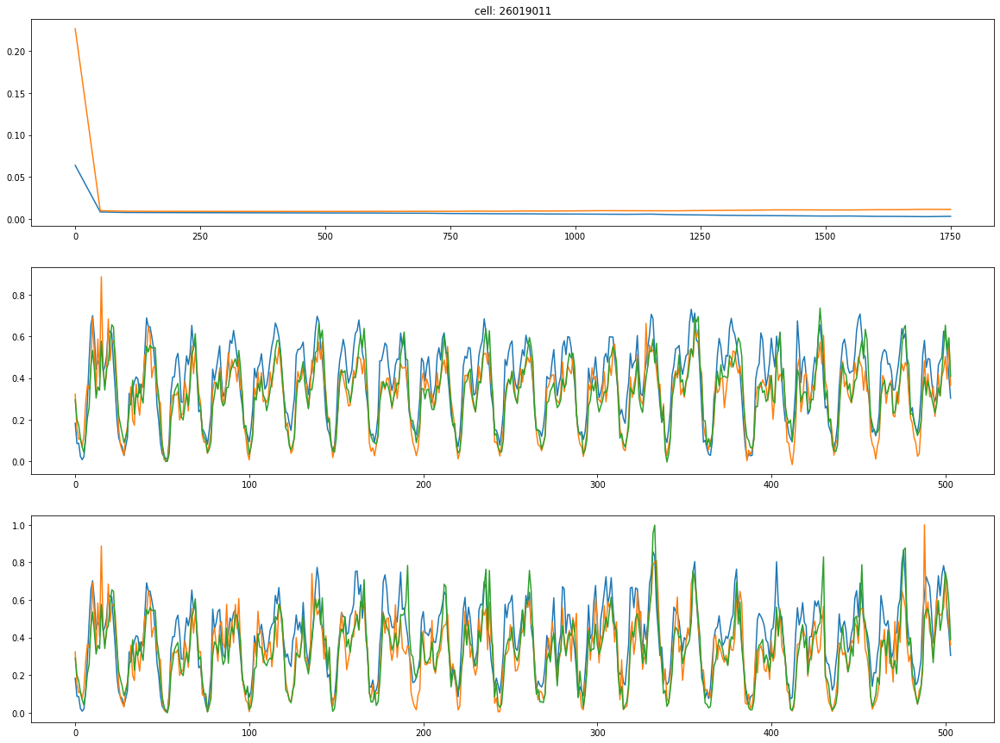

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      2.092498  2.377268e+09     0.238409  2.601903e+07
std       7.118535  8.882765e+09     0.869995  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      52.023730  7.904325e+10     6.821222  2.601906e+07


loss:0.0018507287604734302  test_loss:0.023964911699295044: 100%|██████████| 1800/1800 [00:11<00:00, 152.19it/s]


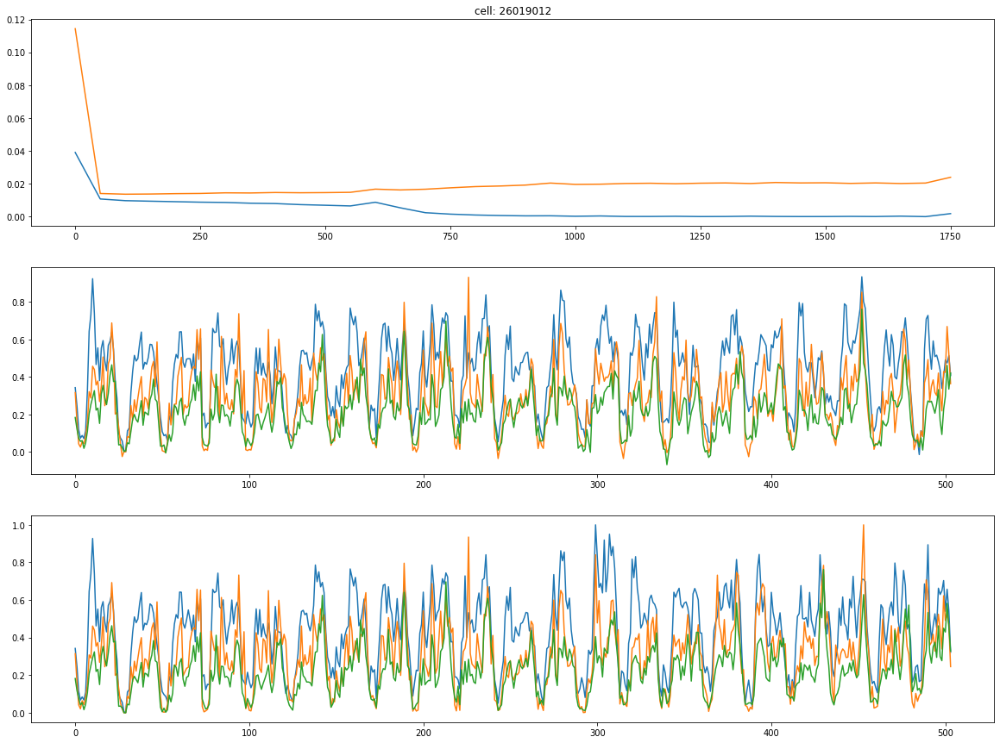

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      2.315318  2.601601e+09     0.265301  2.601903e+07
std       7.272578  9.035658e+09     0.893398  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      52.023730  7.904325e+10     6.821222  2.601906e+07


loss:0.002159574069082737  test_loss:0.01164996437728405: 100%|██████████| 1800/1800 [00:11<00:00, 154.64it/s]


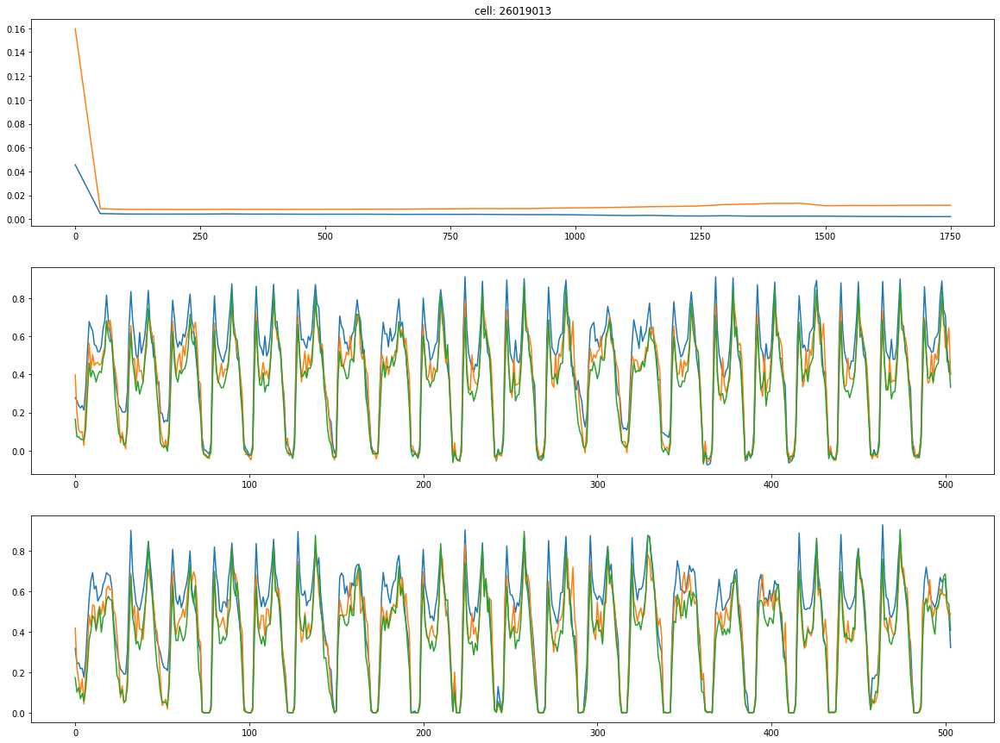

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      2.997415  3.359743e+09     0.333365  2.601903e+07
std       9.297440  1.117231e+10     1.073805  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.005610859487205744  test_loss:0.019906625151634216: 100%|██████████| 1800/1800 [00:11<00:00, 155.46it/s]


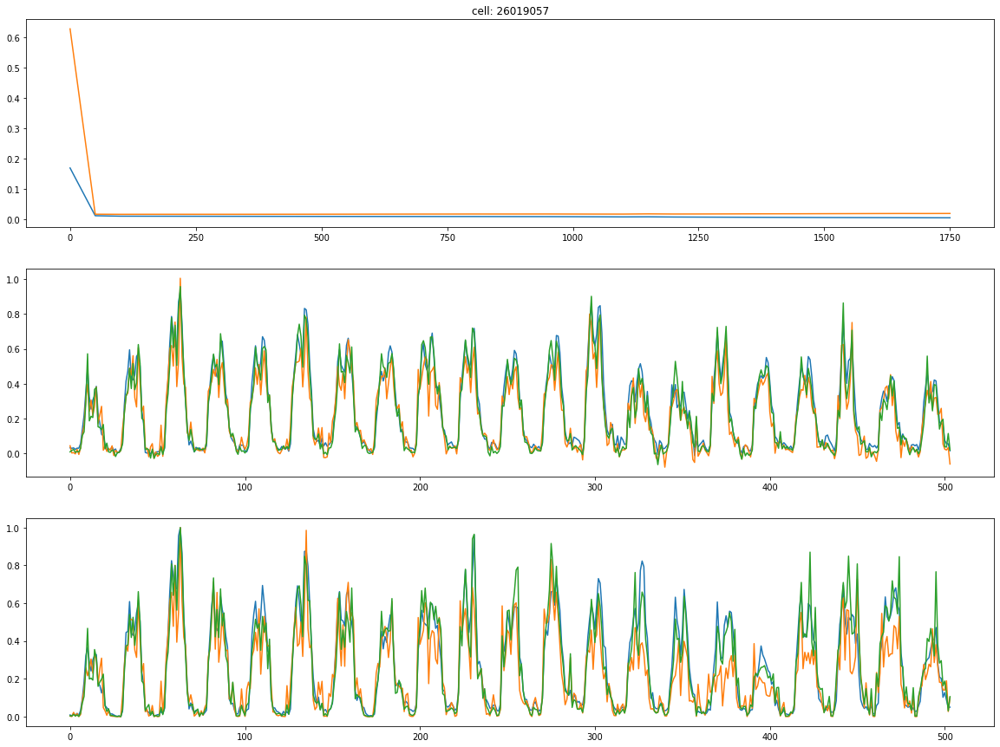

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      3.122499  3.528556e+09     0.344567  2.601903e+07
std       9.337929  1.126139e+10     1.076288  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.0005046805017627776  test_loss:0.04950607940554619: 100%|██████████| 1800/1800 [00:11<00:00, 153.26it/s]


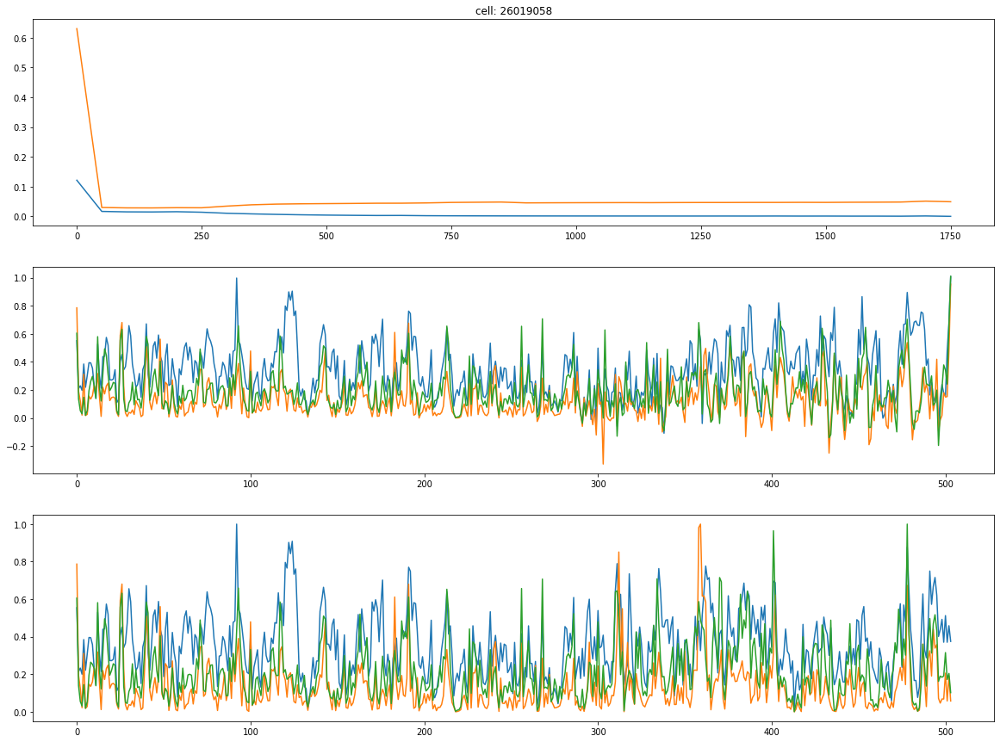

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      3.158052  3.573334e+09     0.348844  2.601903e+07
std       9.330589  1.125687e+10     1.075735  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.00018703629029914737  test_loss:0.04860331863164902: 100%|██████████| 1800/1800 [00:11<00:00, 155.24it/s]


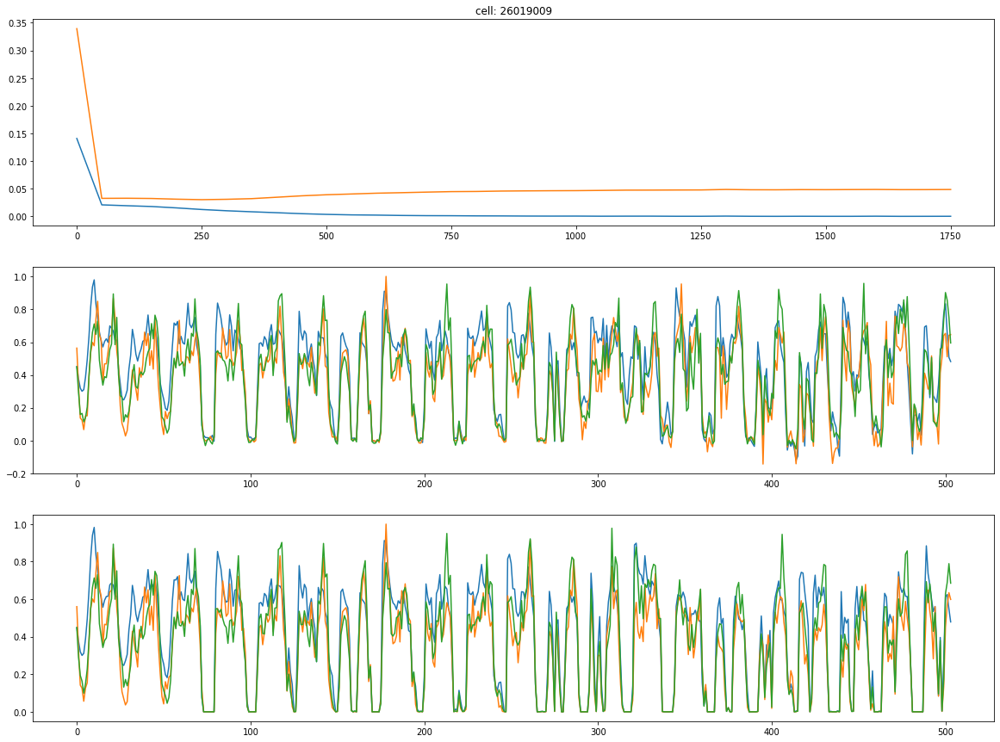

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      3.556463  4.075335e+09     0.387366  2.601903e+07
std       9.893519  1.208355e+10     1.122560  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:8.219588198699057e-05  test_loss:0.016893485561013222: 100%|██████████| 1800/1800 [00:11<00:00, 159.77it/s]


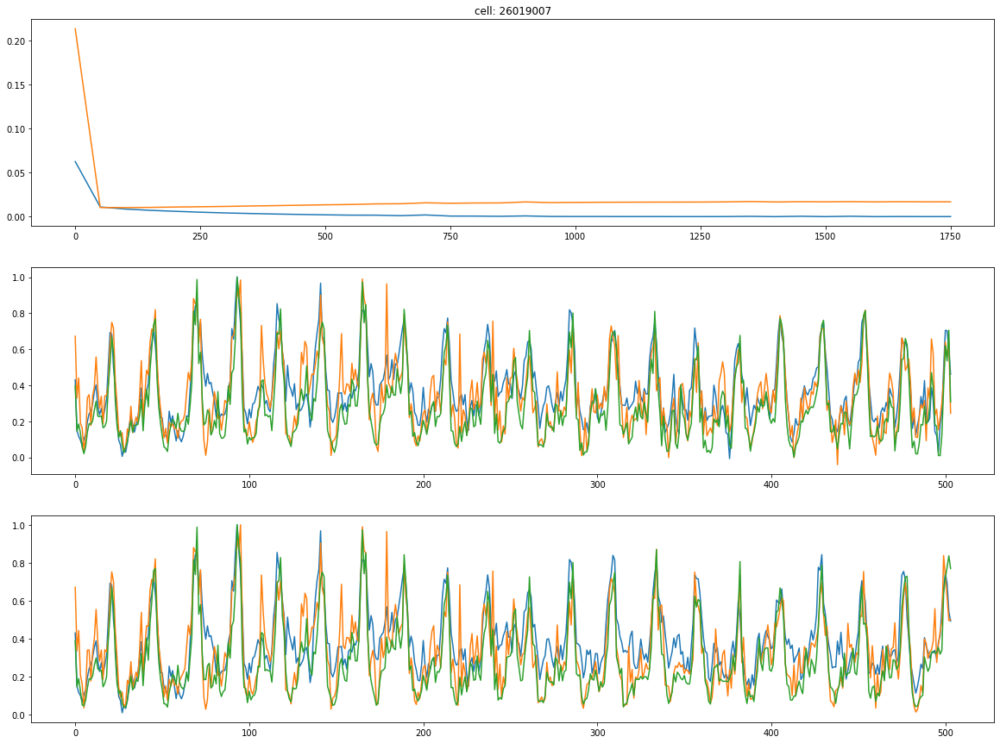

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      3.816648  4.379575e+09     0.416134  2.601903e+07
std      10.007674  1.225114e+10     1.142862  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.00010453118738951162  test_loss:0.029597647488117218: 100%|██████████| 1800/1800 [00:11<00:00, 159.38it/s]


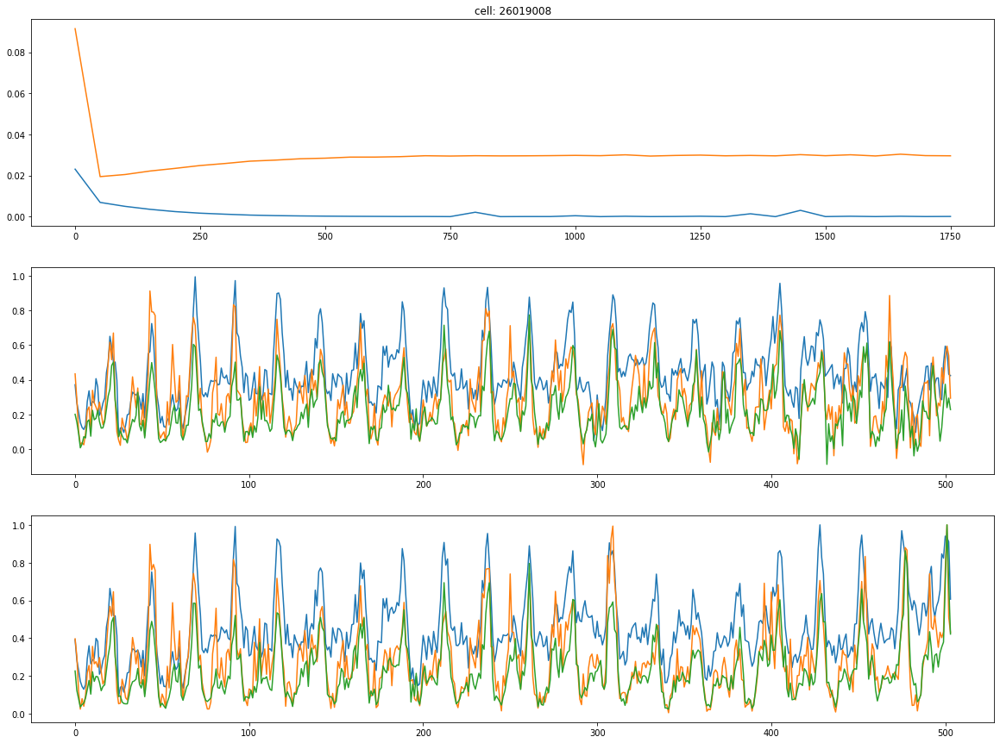

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      4.038162  4.601666e+09     0.440834  2.601903e+07
std      10.081586  1.233623e+10     1.157880  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.000000  0.000000e+00     0.000000  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.0004927918780595064  test_loss:0.03125865012407303: 100%|██████████| 1800/1800 [00:11<00:00, 160.08it/s]


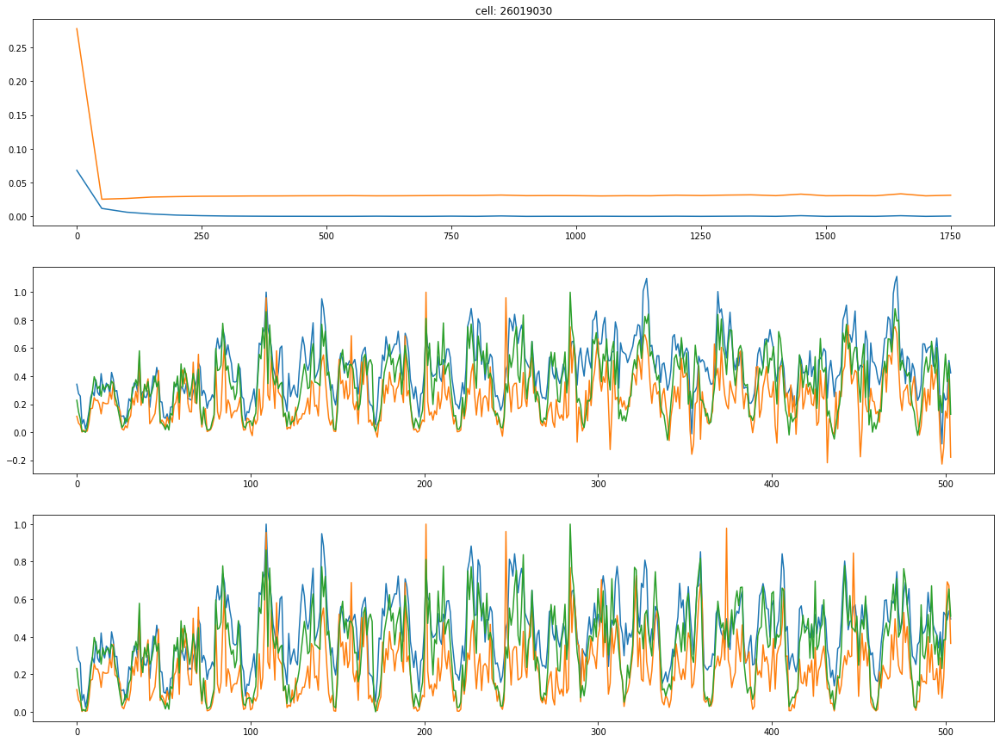

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      4.165322  4.668986e+09     0.455631  2.601903e+07
std      10.080690  1.232597e+10     1.159034  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       0.028100  0.000000e+00     0.000300  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:9.573089300829452e-06  test_loss:0.02037022076547146: 100%|██████████| 1800/1800 [00:11<00:00, 162.88it/s]


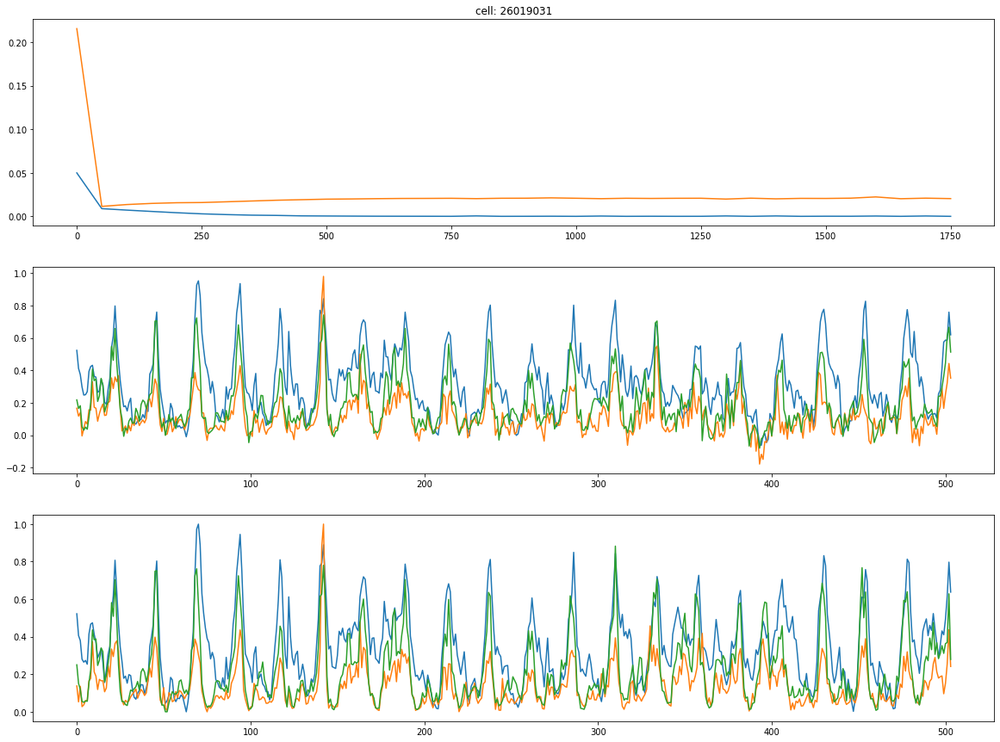

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      4.493709  4.883471e+09     0.481505  2.601903e+07
std      10.263525  1.244120e+10     1.171666  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       1.637764  6.738467e+07     0.122211  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.0001922150404425338  test_loss:0.027293920516967773: 100%|██████████| 1800/1800 [00:11<00:00, 162.50it/s]


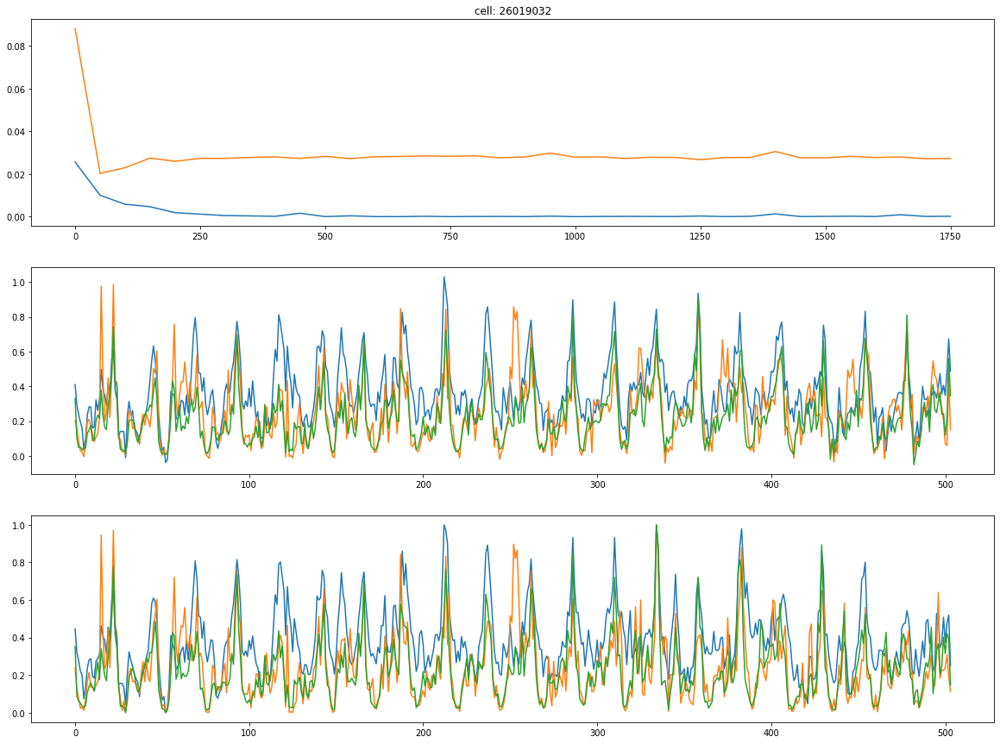

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      4.614877  5.008807e+09     0.494366  2.601903e+07
std      10.254327  1.244389e+10     1.171863  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       2.849569  8.446152e+08     0.221107  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:8.951358177000657e-05  test_loss:0.022977586835622787: 100%|██████████| 1800/1800 [00:11<00:00, 161.32it/s]


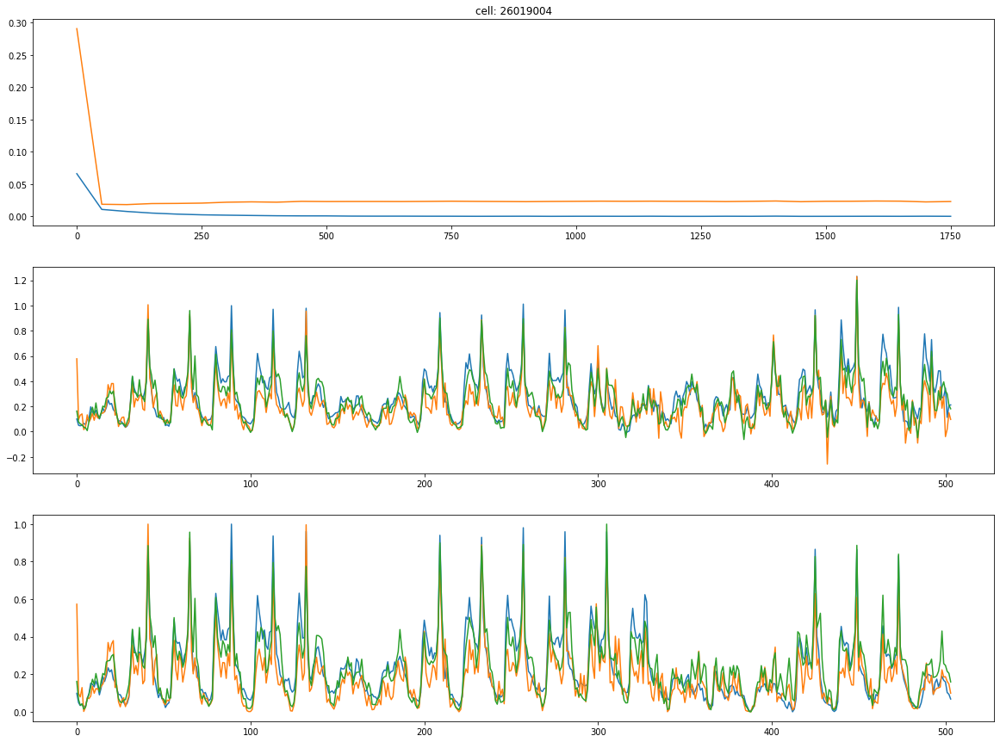

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      4.837862  5.177307e+09     0.514568  2.601903e+07
std      10.321460  1.247694e+10     1.177313  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       4.154881  2.017955e+09     0.317431  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.0003905765188392252  test_loss:0.03260762616991997: 100%|██████████| 1800/1800 [00:11<00:00, 159.68it/s]


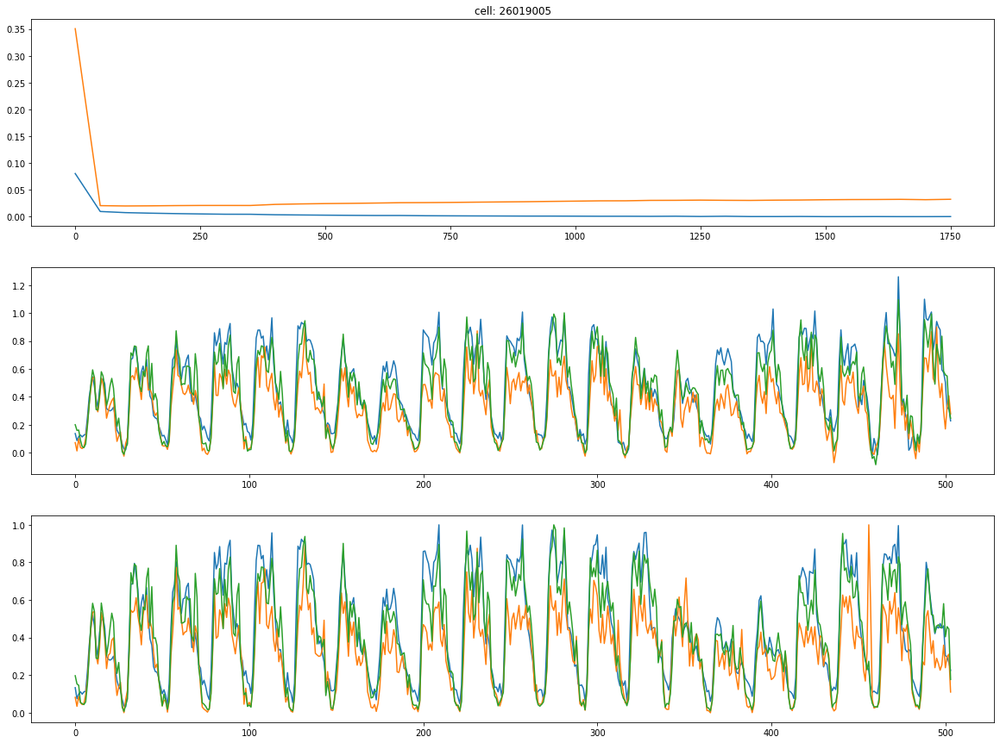

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      5.321055  5.667356e+09     0.561818  2.601903e+07
std      10.859713  1.299283e+10     1.228360  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       5.564508  3.312582e+09     0.419601  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.0015223578084260225  test_loss:0.02510513737797737: 100%|██████████| 1800/1800 [00:11<00:00, 159.09it/s]


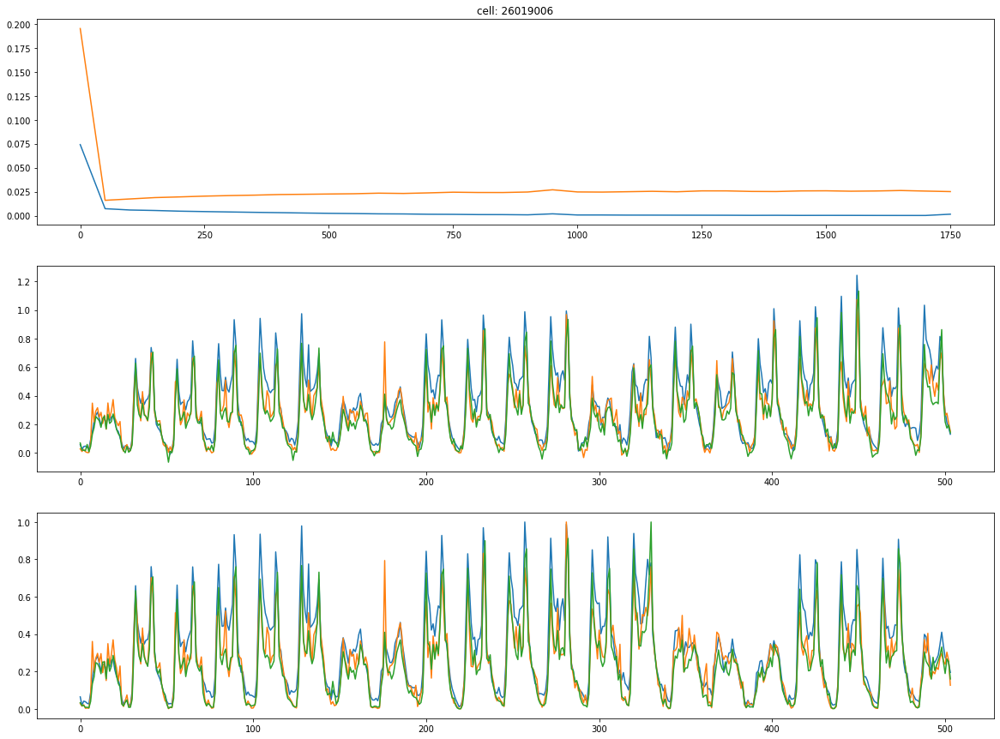

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      5.595828  5.980039e+09     0.600027  2.601903e+07
std      11.000177  1.318454e+10     1.262980  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       6.670064  4.310273e+09     0.525855  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.00011339878983562812  test_loss:0.017306575551629066: 100%|██████████| 1800/1800 [00:11<00:00, 161.00it/s]


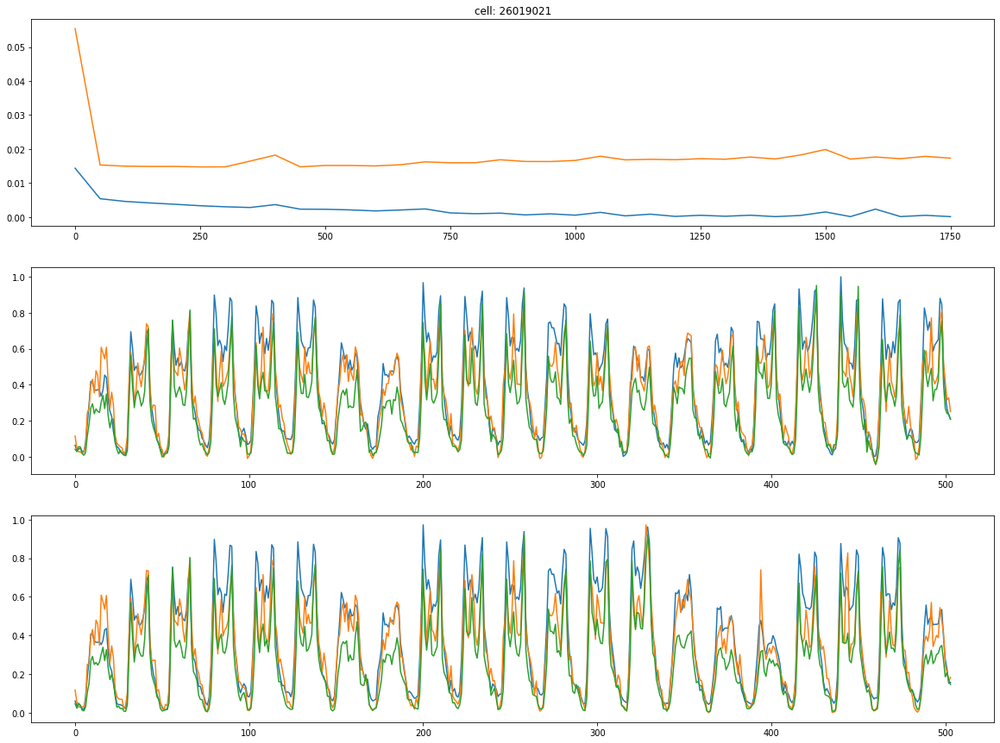

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      6.077040  6.544178e+09     0.657003  2.601903e+07
std      11.487290  1.387848e+10     1.342943  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       7.900311  5.479673e+09     0.622679  2.601904e+07
max      89.535872  9.767070e+10     9.523839  2.601906e+07


loss:0.00019895304285455495  test_loss:0.014406000263988972: 100%|██████████| 1800/1800 [00:11<00:00, 159.96it/s]


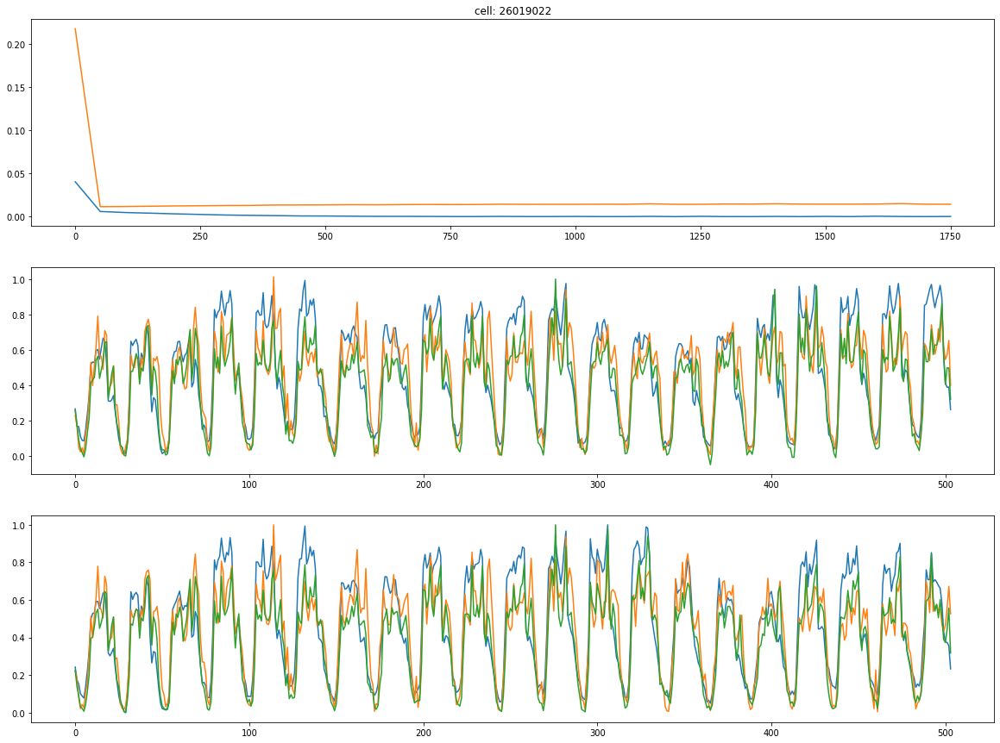

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      6.782993  7.391403e+09     0.742572  2.601903e+07
std      12.536450  1.526844e+10     1.501800  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%       9.067489  6.775069e+09     0.731182  2.601904e+07
max      89.535872  9.767070e+10     9.541495  2.601906e+07


loss:2.715692244237289e-05  test_loss:0.016525203362107277: 100%|██████████| 1800/1800 [00:11<00:00, 161.15it/s]


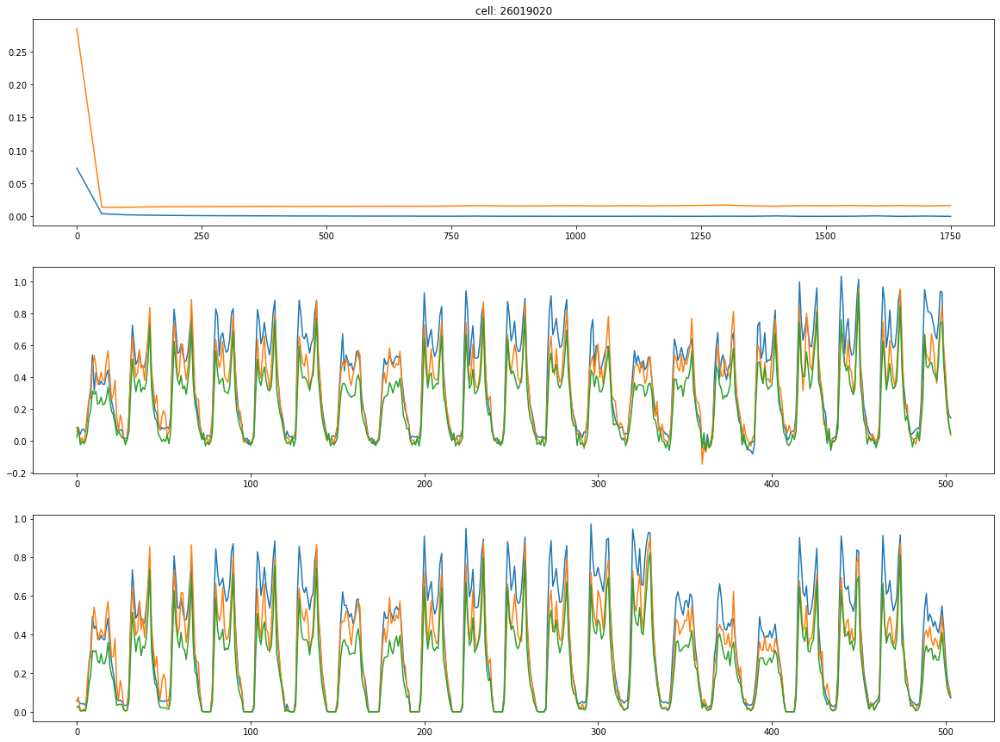

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      7.672922  8.301158e+09     0.828252  2.601903e+07
std      15.114198  1.767637e+10     1.736648  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      10.274899  7.850741e+09     0.828207  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00020255929848644882  test_loss:0.015679968520998955: 100%|██████████| 1800/1800 [00:11<00:00, 161.96it/s]


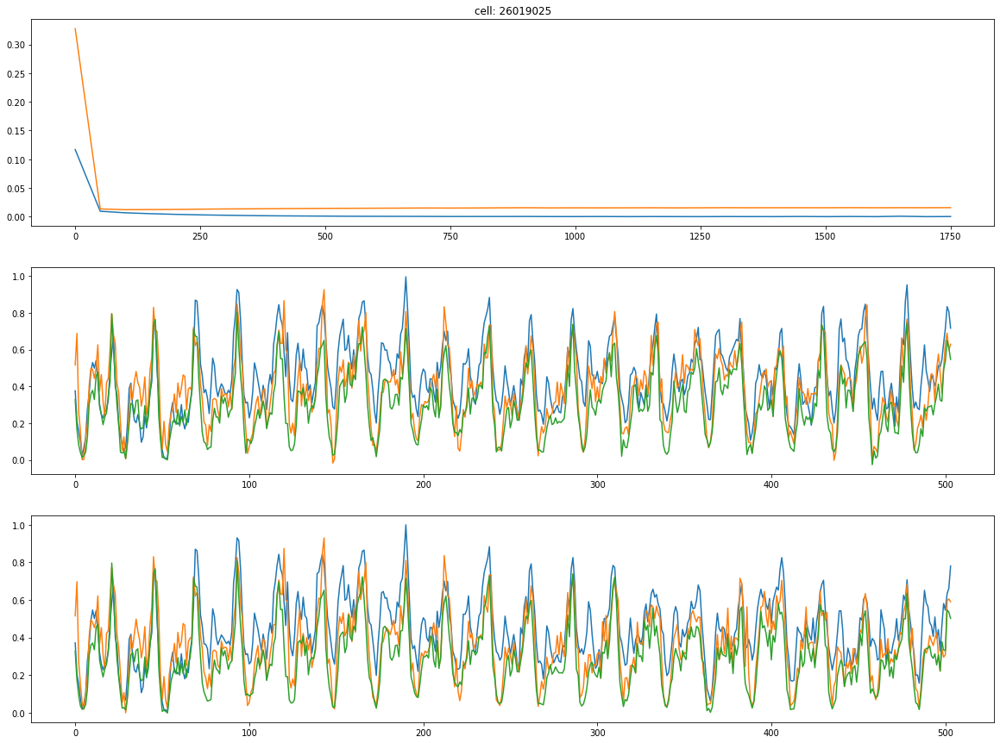

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      8.311951  8.998917e+09     0.876740  2.601903e+07
std      15.594124  1.830425e+10     1.764931  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      11.832177  9.764919e+09     0.950478  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:9.498943836661056e-05  test_loss:0.015607147477567196: 100%|██████████| 1800/1800 [00:11<00:00, 163.33it/s]


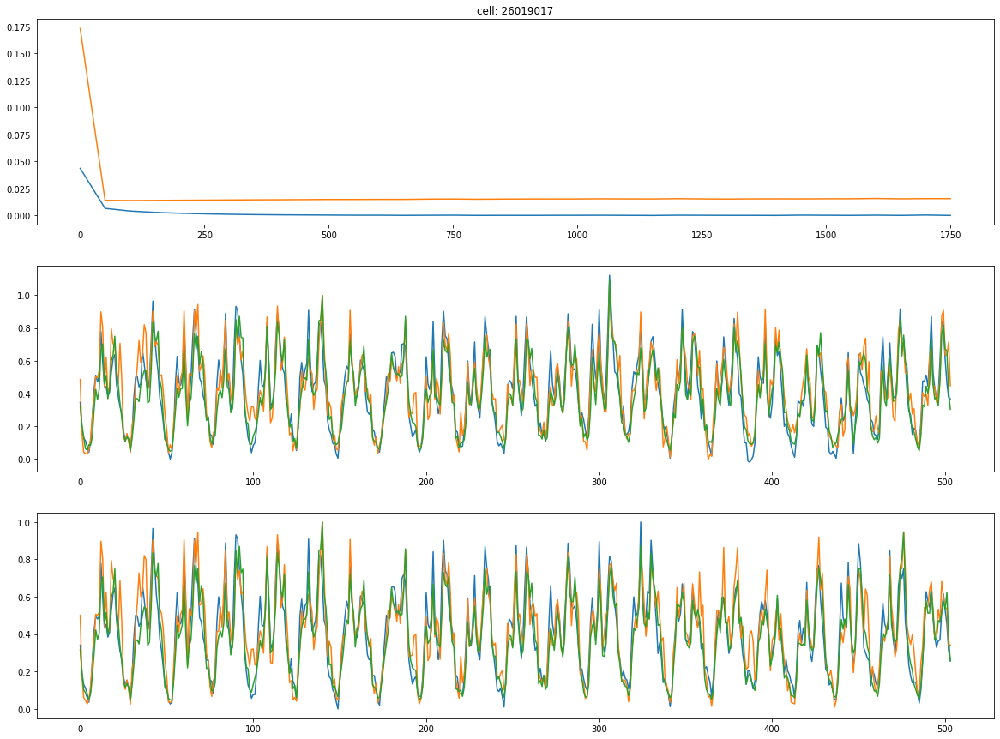

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      8.941523  9.599128e+09     0.943789  2.601903e+07
std      16.056153  1.869049e+10     1.821639  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      13.285772  1.197913e+10     1.109740  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00047066513798199594  test_loss:0.02056024968624115: 100%|██████████| 1800/1800 [00:11<00:00, 162.86it/s]


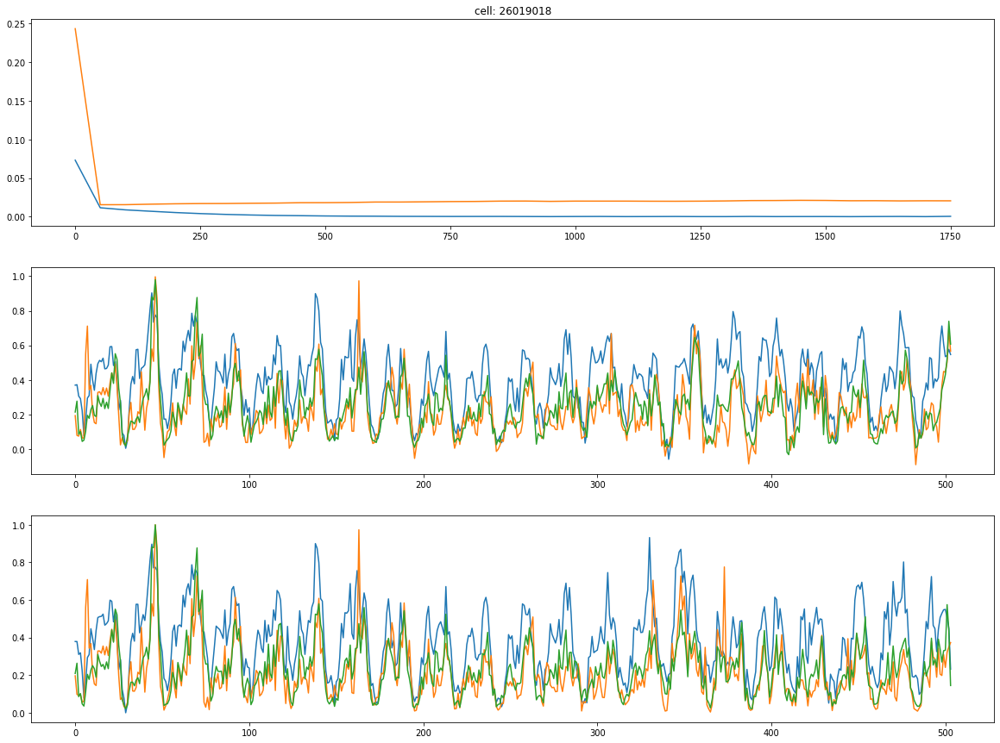

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      9.097367  9.729287e+09     0.961524  2.601903e+07
std      16.017946  1.865932e+10     1.819348  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      13.322776  1.207920e+10     1.201506  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:3.2075469789560884e-05  test_loss:0.018411846831440926: 100%|██████████| 1800/1800 [00:11<00:00, 162.09it/s]


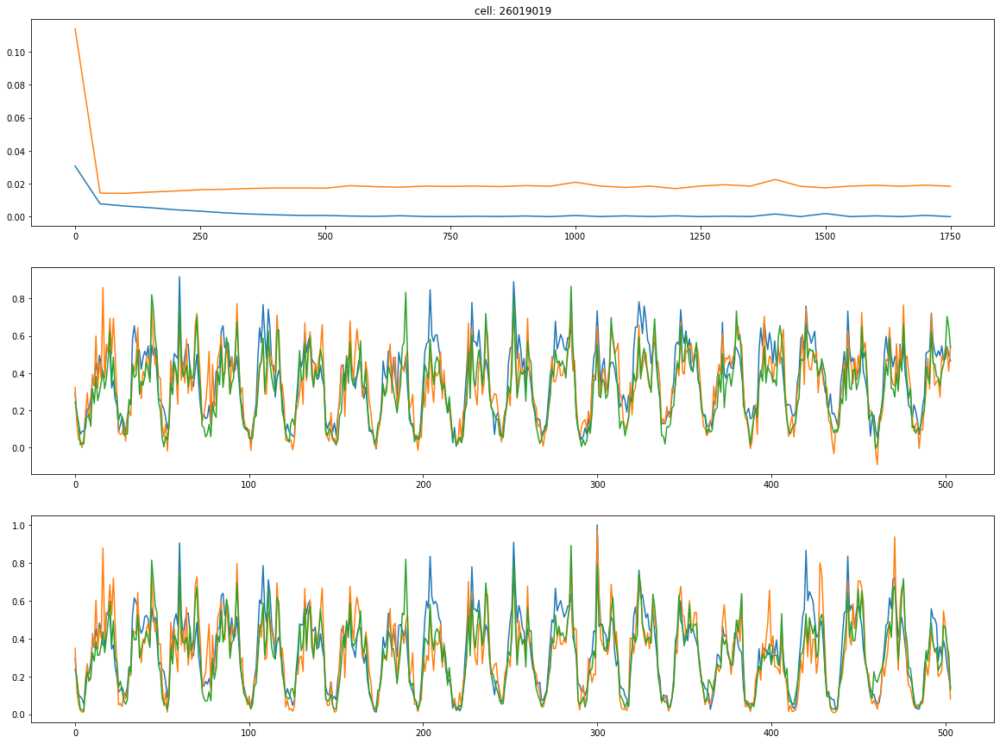

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      9.301029  9.982764e+09     0.984004  2.601903e+07
std      15.989937  1.865163e+10     1.818094  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      13.943587  1.307904e+10     1.293796  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00026793242432177067  test_loss:0.03977008908987045: 100%|██████████| 1800/1800 [00:11<00:00, 160.34it/s]


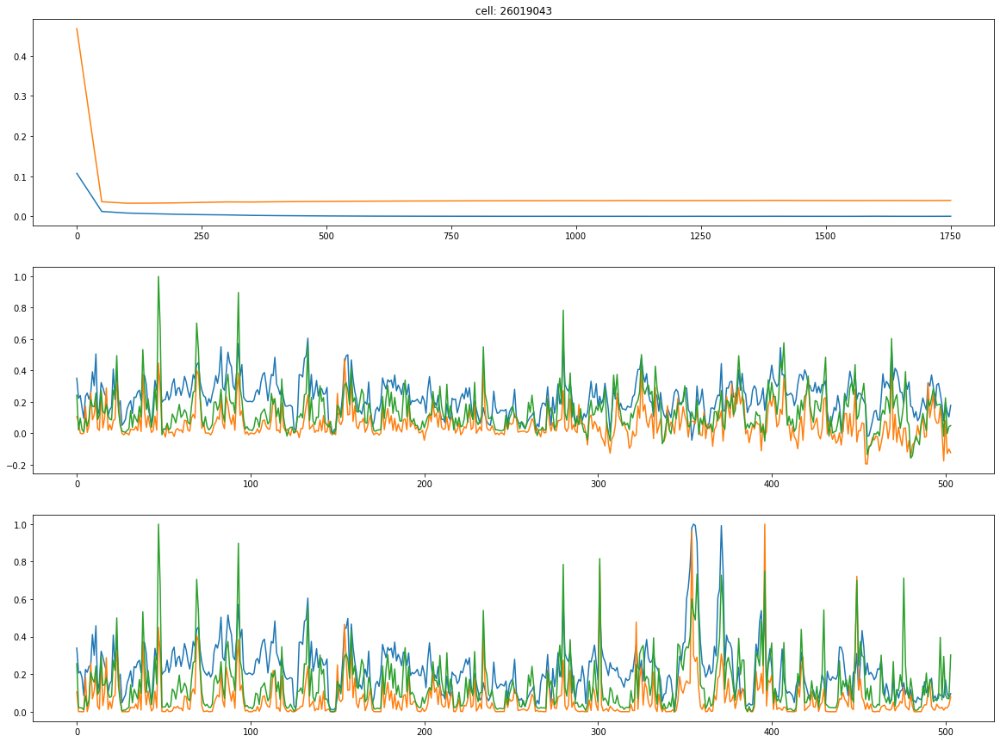

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      9.315748  9.997000e+09     0.985282  2.601903e+07
std      15.981836  1.864458e+10     1.817445  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      13.943587  1.307904e+10     1.293796  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0002321472711628303  test_loss:0.023989232257008553: 100%|██████████| 1800/1800 [00:11<00:00, 159.40it/s]


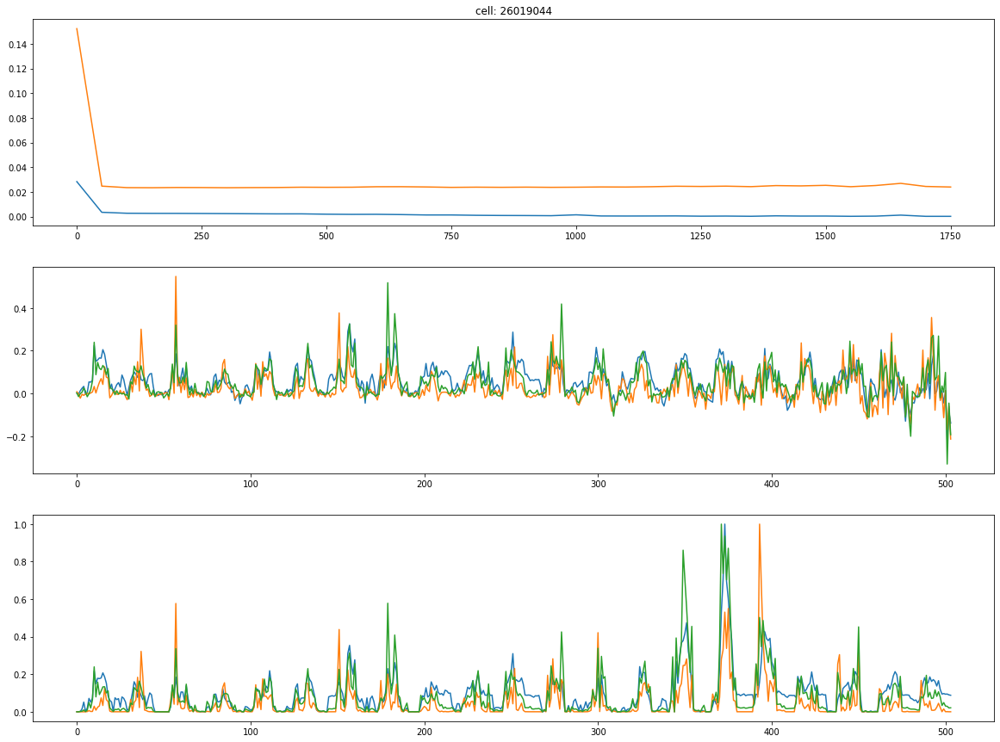

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      9.326436  1.001036e+10     0.986137  2.601903e+07
std      15.976135  1.863845e+10     1.817017  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      13.943587  1.307904e+10     1.293796  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0001607082667760551  test_loss:0.012312246486544609: 100%|██████████| 1800/1800 [00:11<00:00, 153.03it/s]


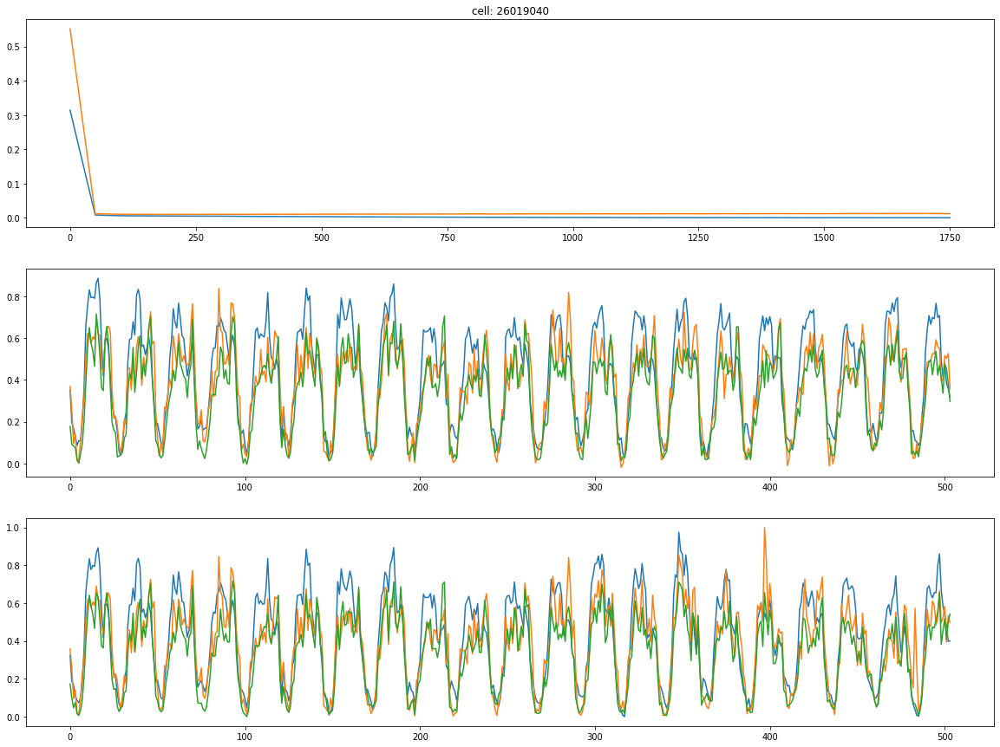

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      9.957335  1.051584e+10     1.062308  2.601903e+07
std      16.403228  1.885976e+10     1.892615  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.000000  0.000000e+00     0.000000  2.601903e+07
75%      15.027063  1.422262e+10     1.414471  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:6.772643246222287e-05  test_loss:0.019685916602611542: 100%|██████████| 1800/1800 [00:10<00:00, 163.64it/s]


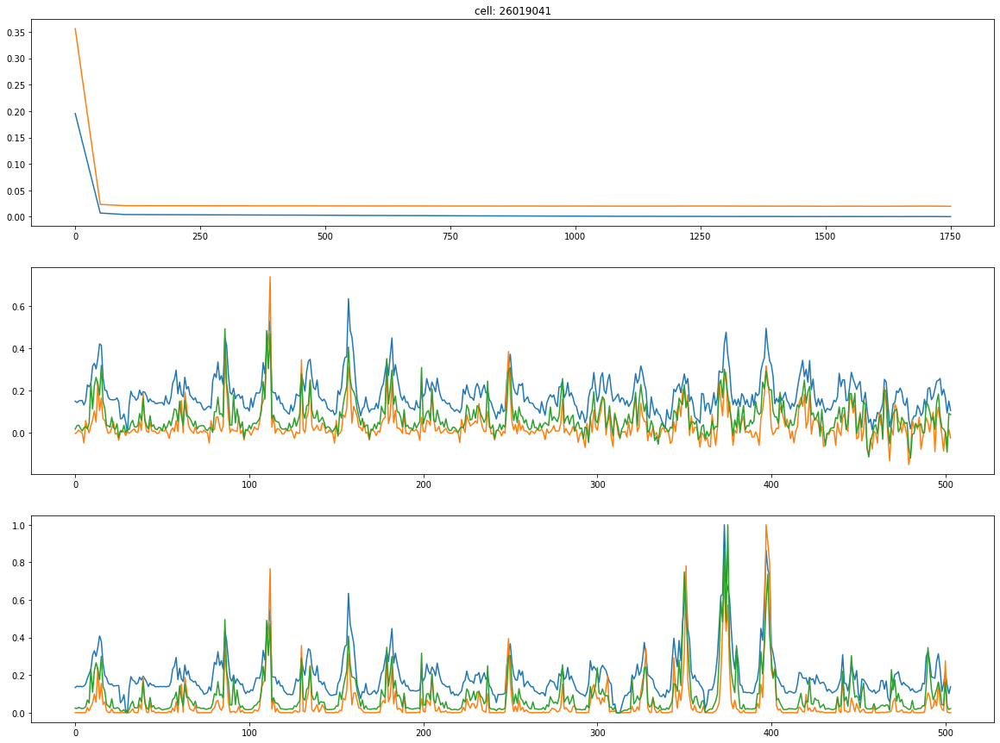

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean      9.974575  1.052900e+10     1.063301  2.601903e+07
std      16.393416  1.885290e+10     1.892083  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.410707  2.303520e+05     0.009105  2.601903e+07
75%      15.027063  1.422262e+10     1.414471  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:8.726770465727895e-05  test_loss:0.016920441761612892: 100%|██████████| 1800/1800 [00:10<00:00, 164.21it/s]


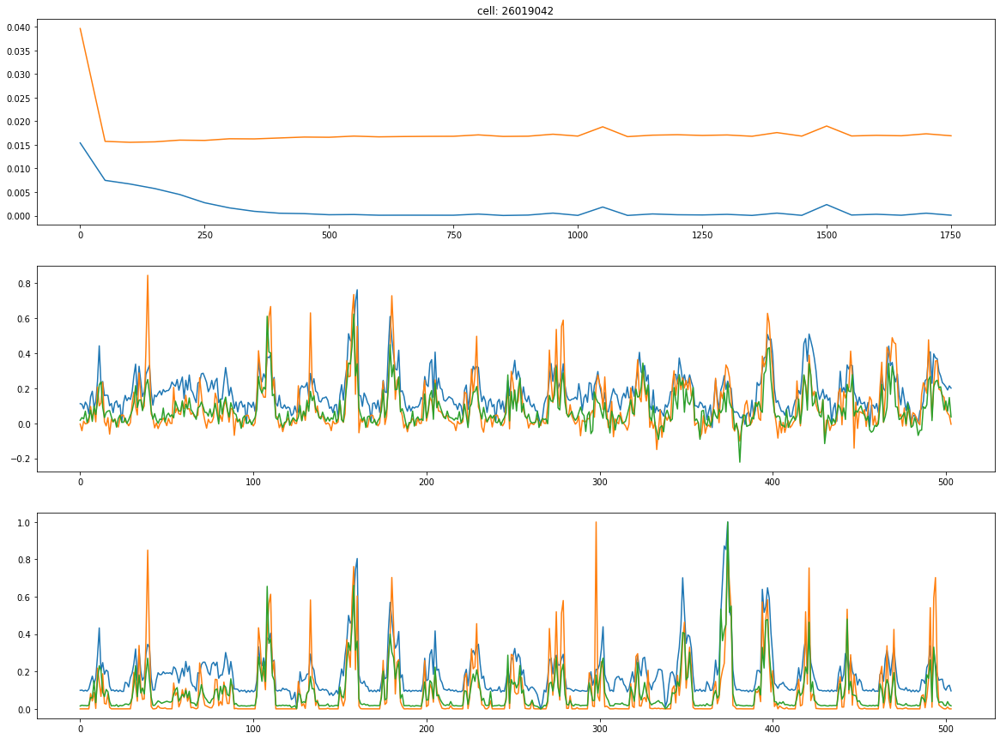

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     10.007726  1.055933e+10     1.065019  2.601903e+07
std      16.375725  1.883867e+10     1.891200  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       0.858375  4.185828e+07     0.034600  2.601903e+07
75%      15.027063  1.422262e+10     1.414471  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00031348722404800355  test_loss:0.024491896852850914: 100%|██████████| 1800/1800 [00:10<00:00, 164.07it/s]


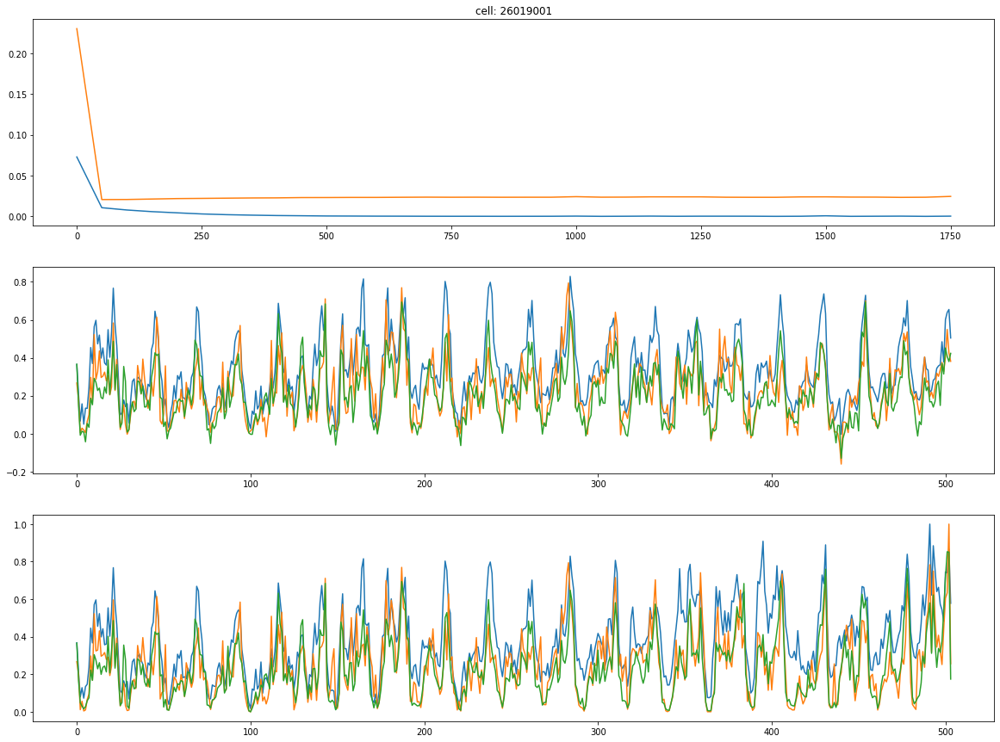

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     10.119956  1.068516e+10     1.079043  2.601903e+07
std      16.330747  1.879655e+10     1.887057  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       1.214652  3.911918e+08     0.063345  2.601903e+07
75%      15.027063  1.422262e+10     1.421188  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0006170011474750936  test_loss:0.016723498702049255: 100%|██████████| 1800/1800 [00:10<00:00, 164.45it/s]


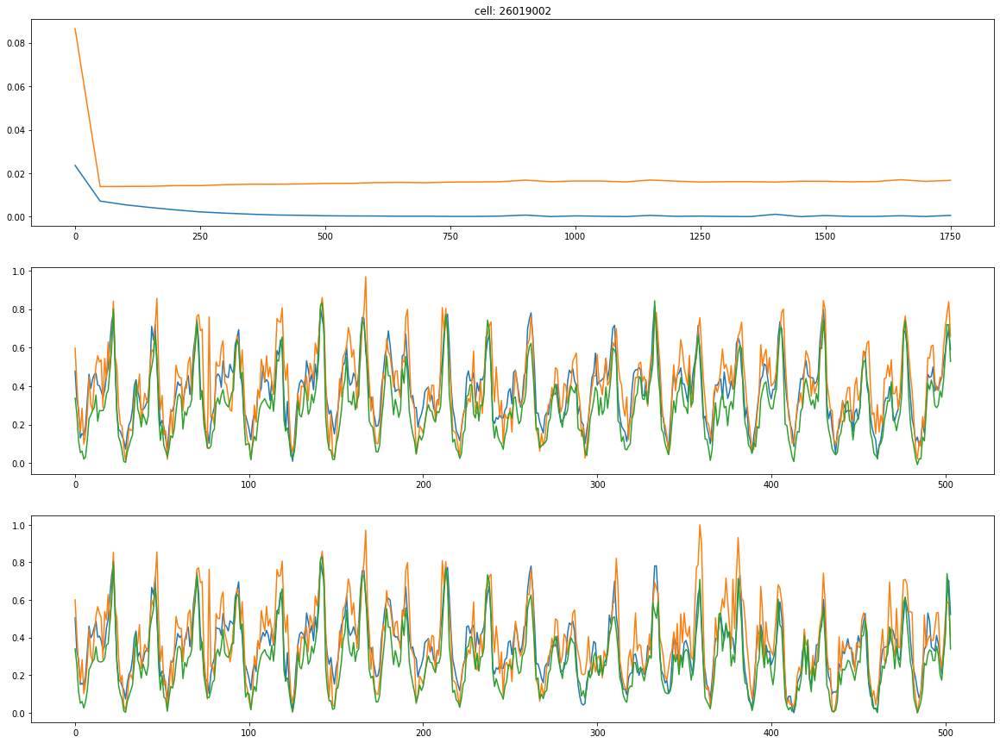

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     10.585976  1.120861e+10     1.139086  2.601903e+07
std      16.445824  1.901527e+10     1.919697  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       1.640667  6.267100e+08     0.099665  2.601903e+07
75%      16.222642  1.570370e+10     1.560053  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0002956055395770818  test_loss:0.017375066876411438: 100%|██████████| 1800/1800 [00:10<00:00, 164.55it/s]


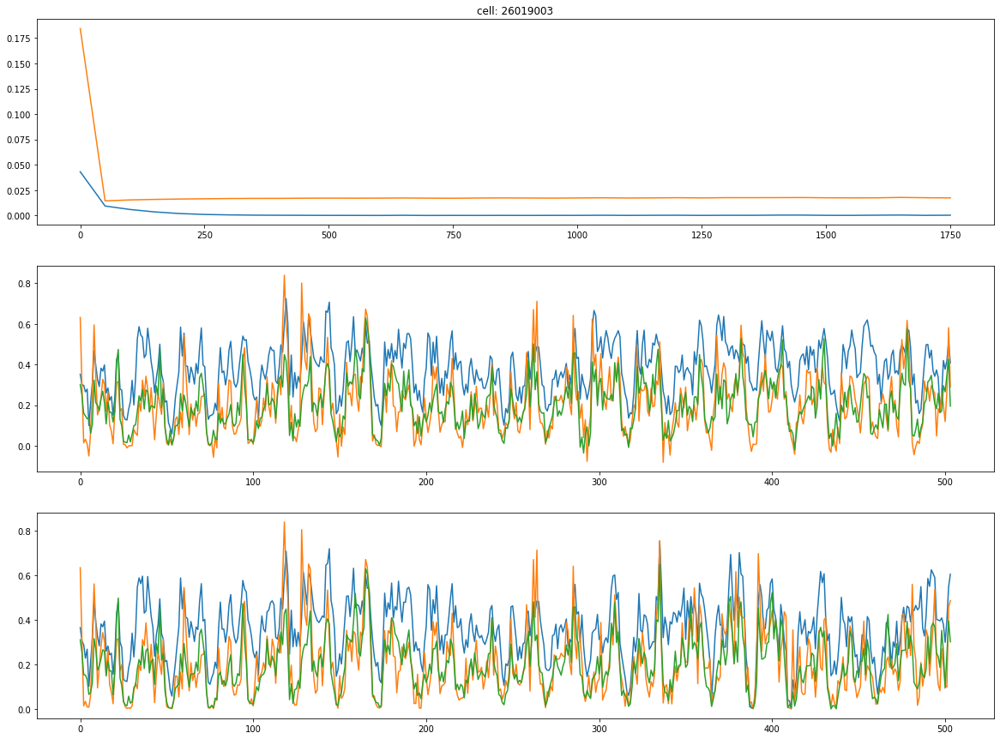

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     10.685722  1.129742e+10     1.151360  2.601903e+07
std      16.399923  1.897923e+10     1.915426  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       2.299440  1.047487e+09     0.136900  2.601903e+07
75%      16.222642  1.570370e+10     1.563135  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00015534472186118364  test_loss:0.016305414959788322: 100%|██████████| 1800/1800 [00:11<00:00, 163.10it/s]


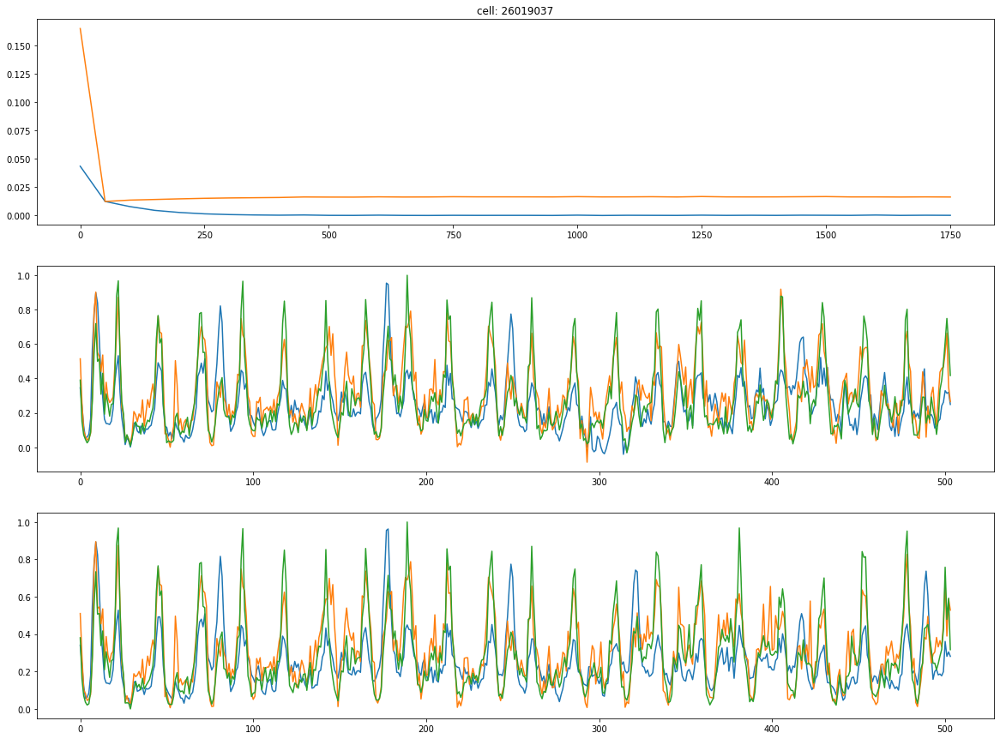

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     11.159670  1.190639e+10     1.210107  2.601903e+07
std      16.531621  1.931165e+10     1.950918  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       3.150850  1.478937e+09     0.187822  2.601903e+07
75%      17.620808  1.716273e+10     1.721348  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0001917736663017422  test_loss:0.021848974749445915: 100%|██████████| 1800/1800 [00:10<00:00, 164.63it/s]


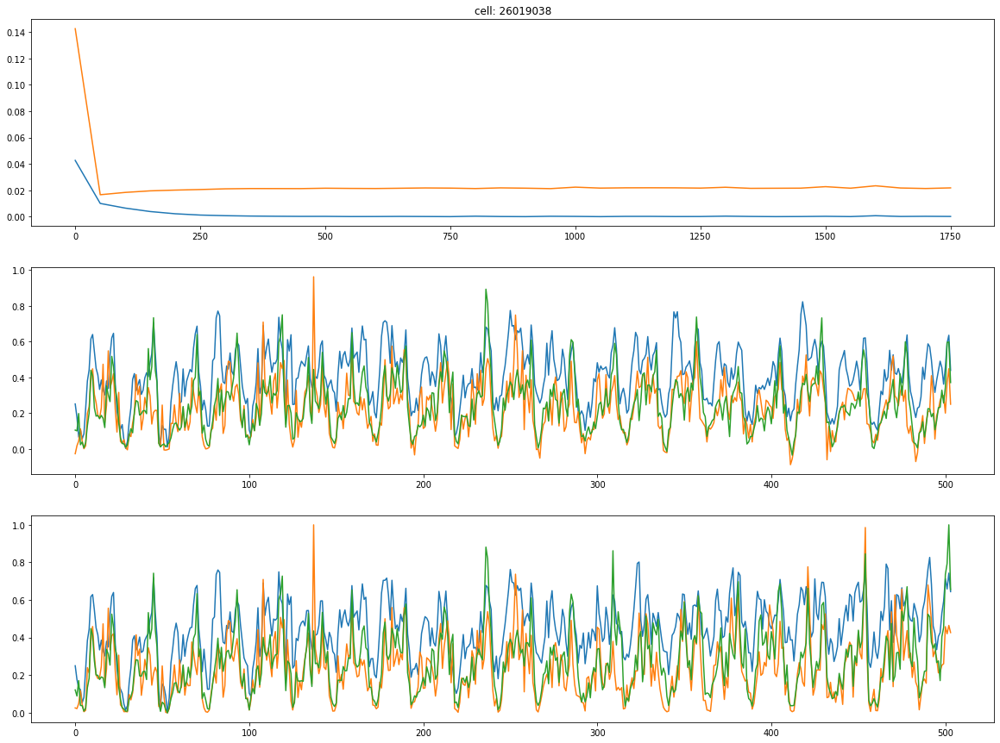

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     11.270610  1.201933e+10     1.224786  2.601903e+07
std      16.480026  1.926700e+10     1.945704  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       3.761806  1.989152e+09     0.238879  2.601903e+07
75%      17.620808  1.716273e+10     1.723083  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0002044058492174372  test_loss:0.019660403952002525: 100%|██████████| 1800/1800 [00:10<00:00, 163.87it/s]


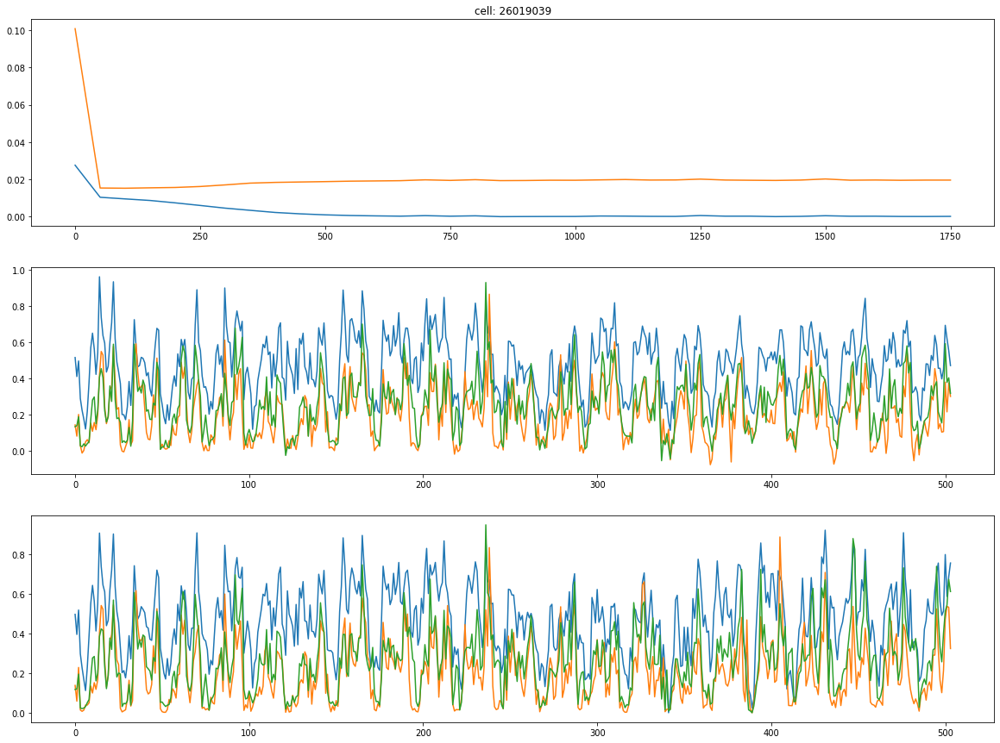

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     11.390268  1.215174e+10     1.237129  2.601903e+07
std      16.424226  1.922063e+10     1.940858  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       4.474380  2.514597e+09     0.310958  2.601903e+07
75%      17.620808  1.720694e+10     1.723083  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00019672045891638845  test_loss:0.04232225939631462: 100%|██████████| 1800/1800 [00:10<00:00, 164.28it/s]


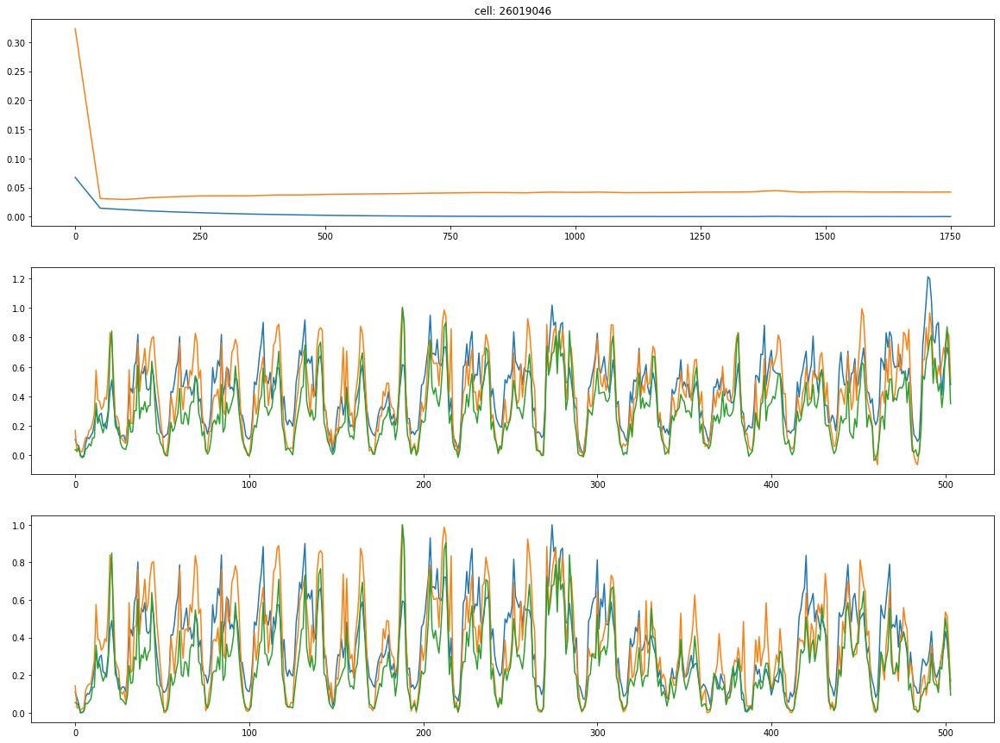

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     11.635977  1.260129e+10     1.271400  2.601903e+07
std      16.395284  1.942018e+10     1.953028  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       4.998612  3.155946e+09     0.359695  2.601903e+07
75%      17.939881  1.839311e+10     1.782698  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00037988656549714506  test_loss:0.025677215307950974: 100%|██████████| 1800/1800 [00:11<00:00, 160.65it/s]


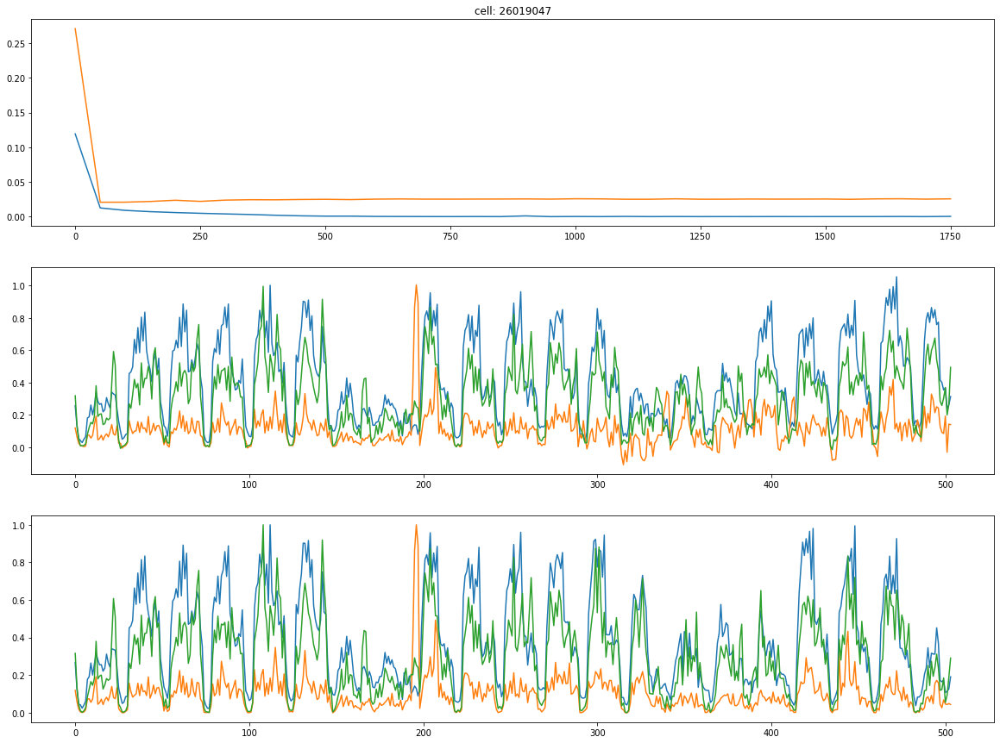

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     11.747178  1.276513e+10     1.284891  2.601903e+07
std      16.346390  1.943521e+10     1.949467  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       5.330113  3.438405e+09     0.402774  2.601903e+07
75%      17.939881  1.880567e+10     1.816264  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:1.1556079698493704e-05  test_loss:0.026224186643958092: 100%|██████████| 1800/1800 [00:11<00:00, 158.66it/s]


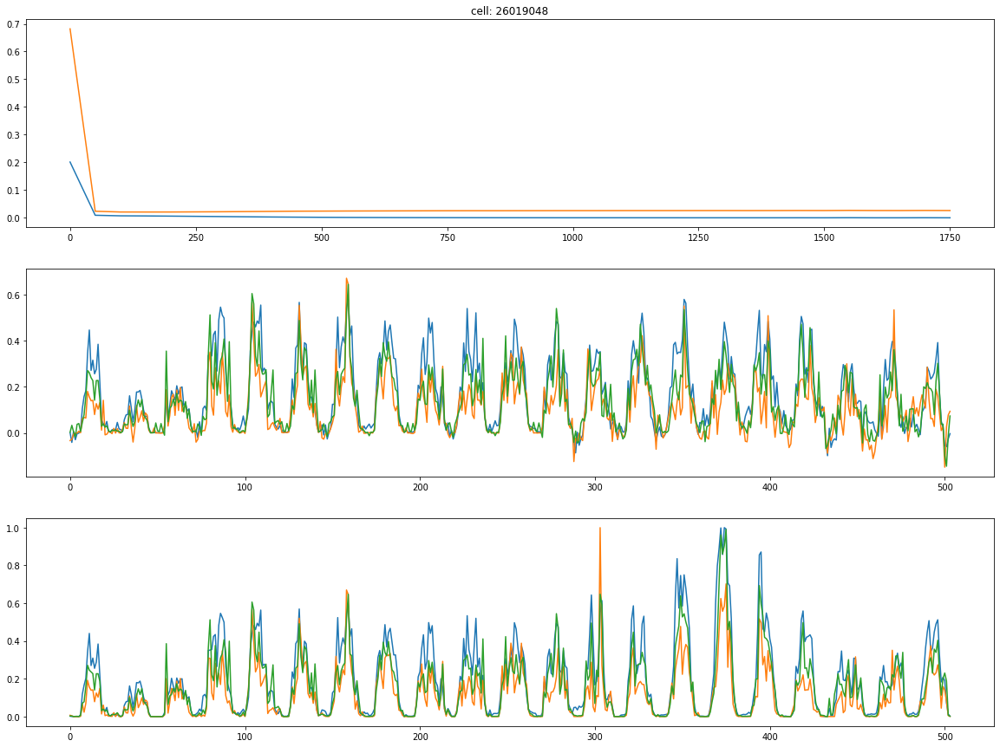

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     11.800188  1.281978e+10     1.289190  2.601903e+07
std      16.317791  1.940939e+10     1.947176  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       5.559622  3.732947e+09     0.420358  2.601903e+07
75%      17.939881  1.880567e+10     1.816264  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00018931247177533805  test_loss:0.04474910721182823: 100%|██████████| 1800/1800 [00:11<00:00, 162.46it/s]


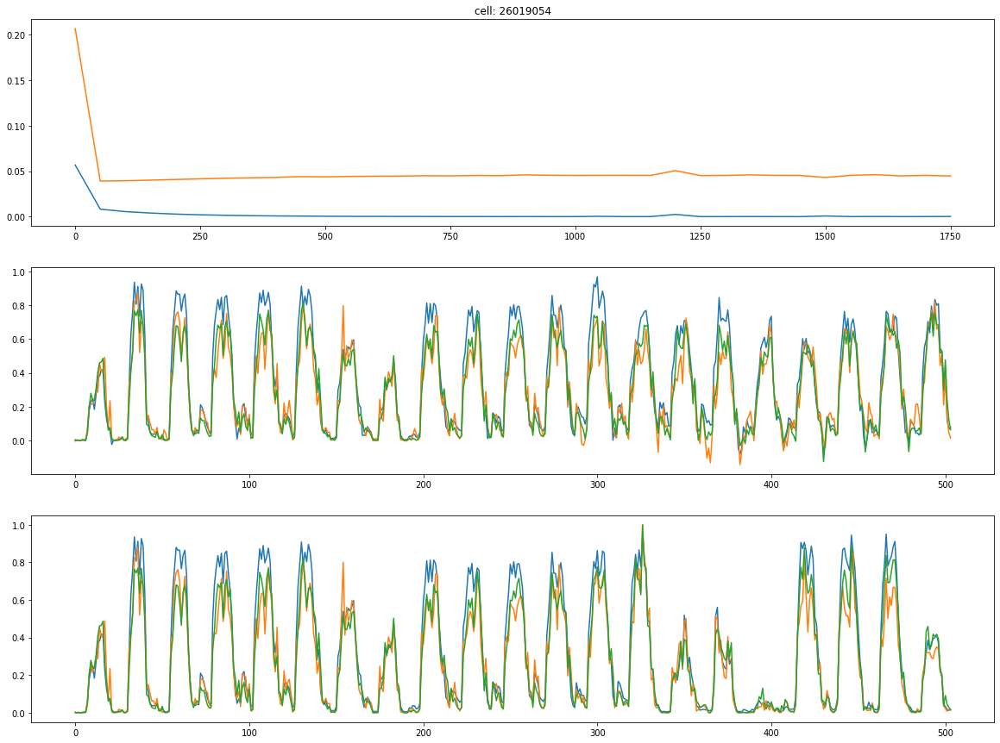

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     12.156887  1.331802e+10     1.324517  2.601903e+07
std      16.398898  1.964448e+10     1.953224  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       5.992960  4.293991e+09     0.474472  2.601903e+07
75%      18.719610  1.979218e+10     1.885668  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00046253015170805156  test_loss:0.04396878555417061: 100%|██████████| 1800/1800 [00:10<00:00, 164.01it/s]


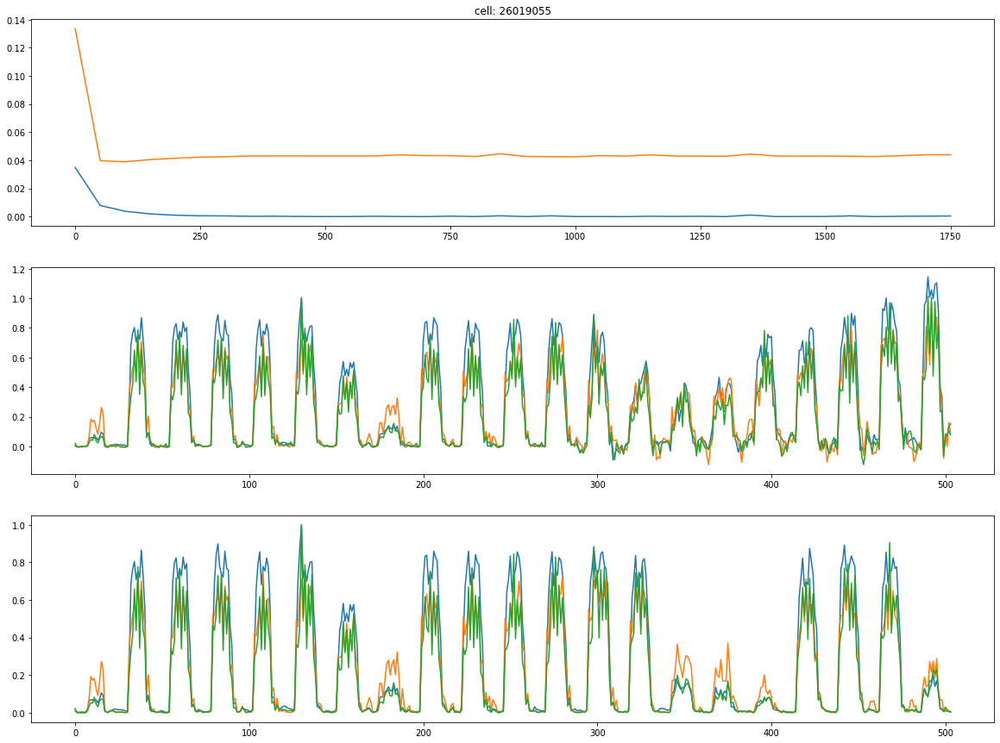

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     12.363564  1.362280e+10     1.355150  2.601903e+07
std      16.420205  1.972715e+10     1.964821  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       6.213022  4.712536e+09     0.520697  2.601903e+07
75%      19.134273  2.046378e+10     1.956305  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0022502585779875517  test_loss:0.043987877666950226: 100%|██████████| 1800/1800 [00:11<00:00, 163.25it/s]


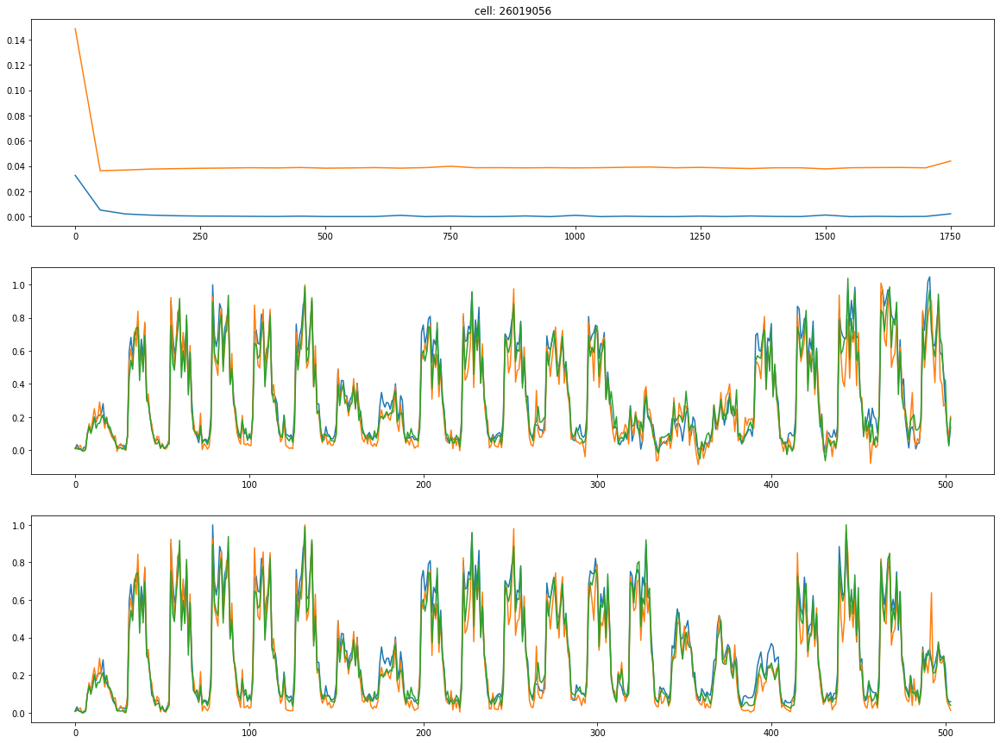

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     12.507212  1.385501e+10     1.373542  2.601903e+07
std      16.379412  1.970439e+10     1.960225  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       6.420064  5.149696e+09     0.573638  2.601903e+07
75%      19.382279  2.085698e+10     1.977781  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:7.63188800192438e-05  test_loss:0.05983336269855499: 100%|██████████| 1800/1800 [00:10<00:00, 163.70it/s]


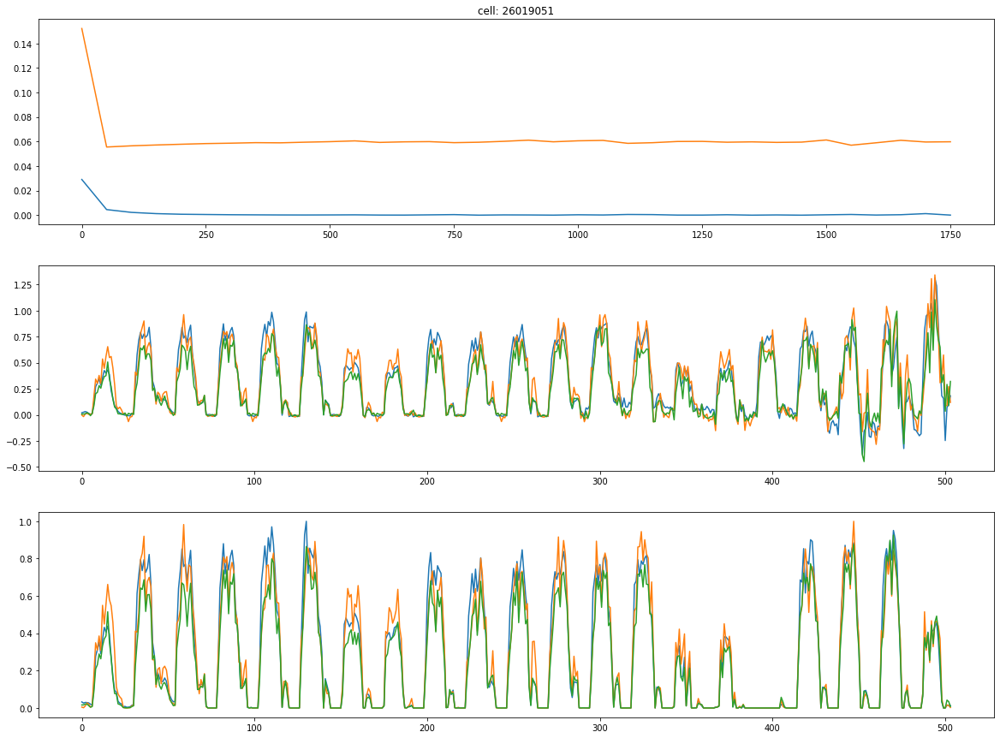

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     12.827859  1.437305e+10     1.401664  2.601903e+07
std      16.532814  2.019293e+10     1.973204  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.000000  0.000000e+00     0.000000  2.601902e+07
50%       6.721415  5.573302e+09     0.603652  2.601903e+07
75%      19.860576  2.144151e+10     2.030474  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0008403777610510588  test_loss:0.05225883796811104: 100%|██████████| 1800/1800 [00:10<00:00, 163.77it/s]


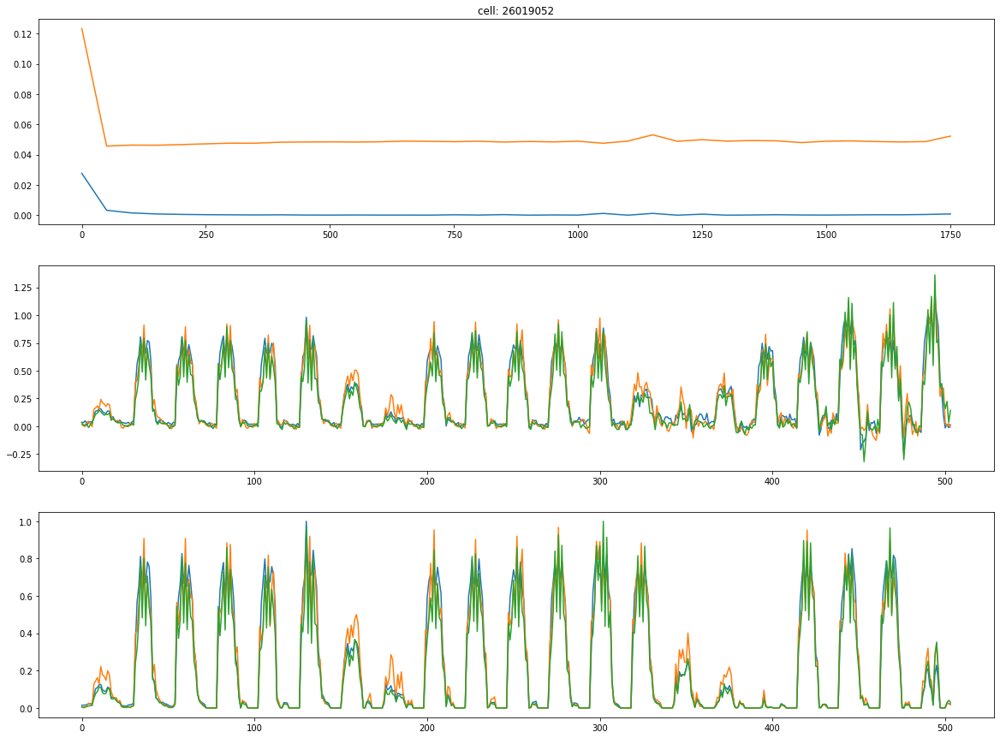

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     13.231099  1.490083e+10     1.440028  2.601903e+07
std      16.838035  2.074245e+10     2.006615  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.074200  0.000000e+00     0.000150  2.601902e+07
50%       7.058831  5.926340e+09     0.631067  2.601903e+07
75%      20.329316  2.235532e+10     2.096527  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:3.408292468520813e-05  test_loss:0.04824218526482582: 100%|██████████| 1800/1800 [00:10<00:00, 164.12it/s]


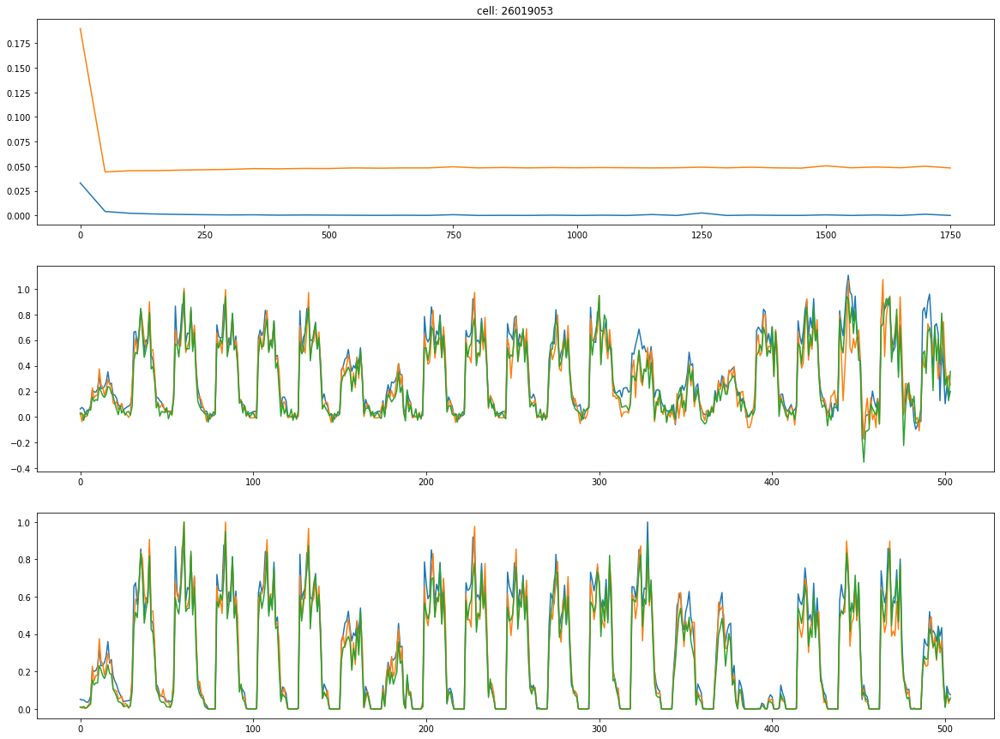

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     13.614349  1.531818e+10     1.455662  2.601903e+07
std      16.946058  2.088828e+10     2.002154  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.395738  4.338320e+05     0.001200  2.601902e+07
50%       7.406961  6.400332e+09     0.659712  2.601903e+07
75%      20.967812  2.310100e+10     2.115790  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00031759883859194815  test_loss:0.032152701169252396: 100%|██████████| 1800/1800 [00:10<00:00, 163.80it/s]


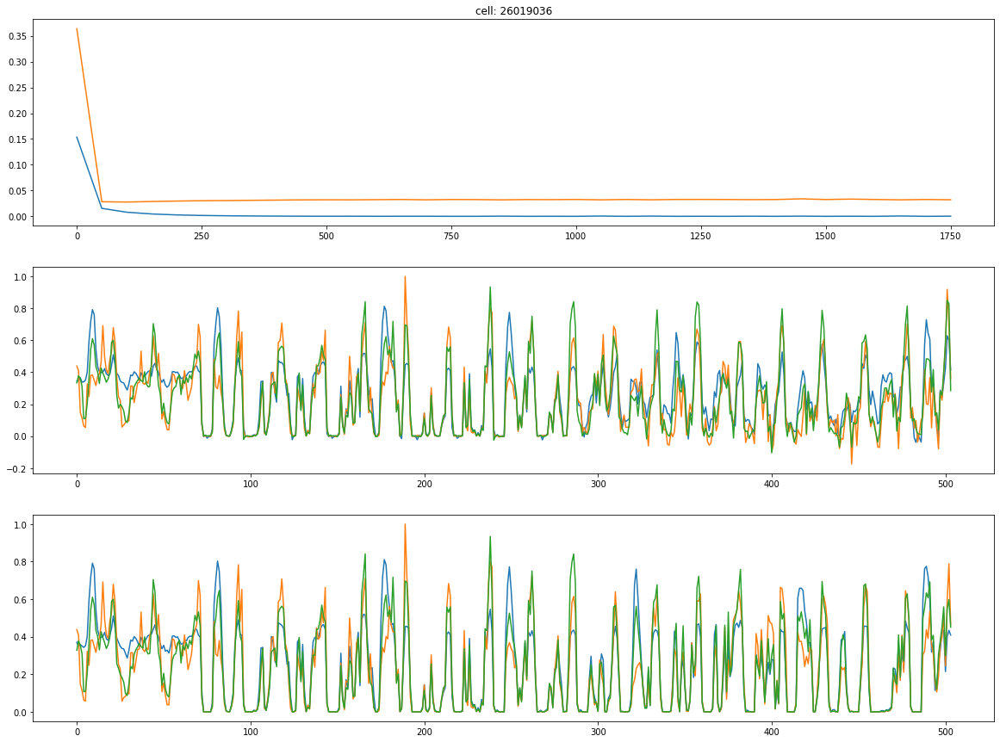

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     13.851594  1.555343e+10     1.474905  2.601903e+07
std      16.905008  2.087205e+10     1.998947  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.741925  1.630954e+07     0.015187  2.601902e+07
50%       7.718675  6.808678e+09     0.695257  2.601903e+07
75%      21.313769  2.381896e+10     2.155730  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0005782013176940382  test_loss:0.03397615998983383: 100%|██████████| 1800/1800 [00:10<00:00, 163.83it/s]


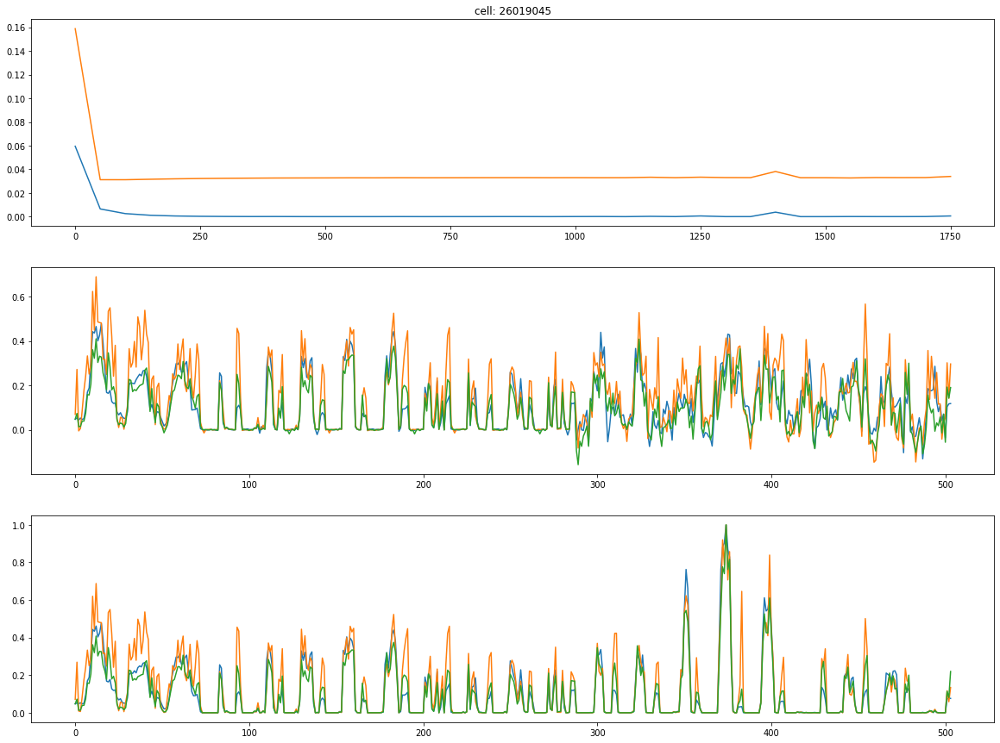

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     13.958373  1.568976e+10     1.482901  2.601903e+07
std      16.865326  2.081951e+10     1.995065  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       0.967103  4.070249e+07     0.034429  2.601902e+07
50%       7.851173  7.177247e+09     0.708648  2.601903e+07
75%      21.364875  2.387089e+10     2.155730  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.00016304379096254706  test_loss:0.01611364260315895: 100%|██████████| 1800/1800 [00:10<00:00, 163.82it/s]


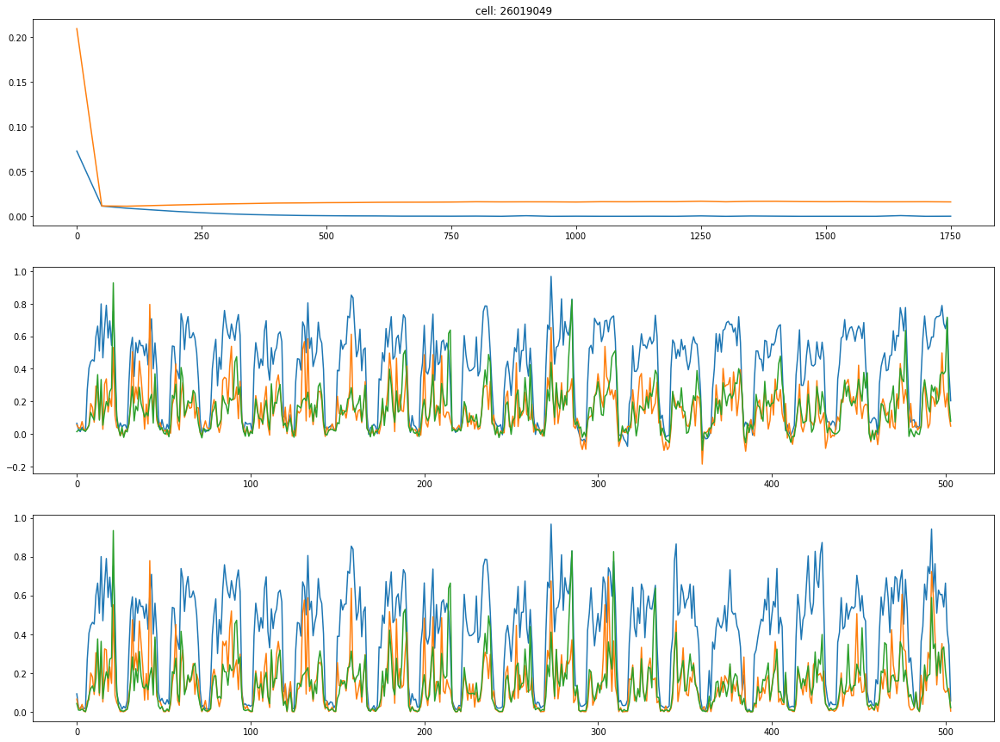

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     13.982130  1.570543e+10     1.484591  2.601903e+07
std      16.847046  2.080858e+10     1.993902  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       1.141170  1.680316e+08     0.045596  2.601902e+07
50%       7.851173  7.177247e+09     0.708648  2.601903e+07
75%      21.364875  2.387089e+10     2.155730  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0006591736455447972  test_loss:0.030344020575284958: 100%|██████████| 1800/1800 [00:11<00:00, 163.50it/s]


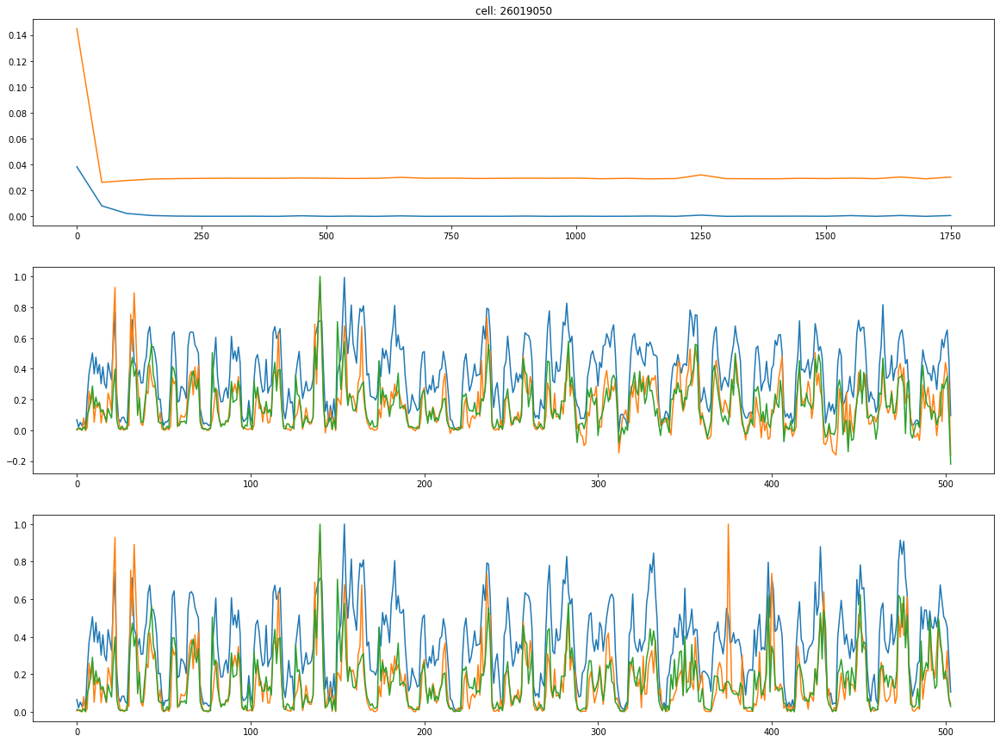

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.008159  1.573797e+10     1.487797  2.601903e+07
std      16.827084  2.078674e+10     1.991807  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       1.291516  3.770337e+08     0.059512  2.601902e+07
50%       7.851173  7.178651e+09     0.708648  2.601903e+07
75%      21.364875  2.387089e+10     2.155730  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0011445736745372415  test_loss:0.01447453536093235: 100%|██████████| 1800/1800 [00:11<00:00, 162.82it/s]


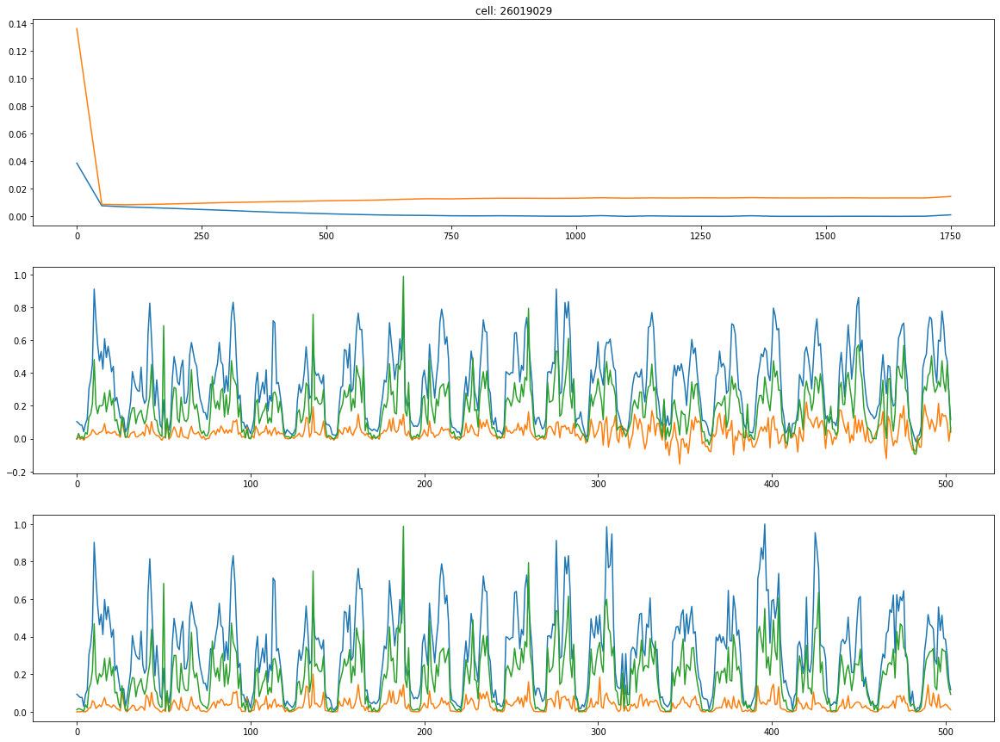

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.032196  1.583777e+10     1.490564  2.601903e+07
std      16.808571  2.073995e+10     1.989949  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       1.423719  4.915671e+08     0.069309  2.601902e+07
50%       7.851173  7.429331e+09     0.708648  2.601903e+07
75%      21.364875  2.387089e+10     2.155730  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:7.057570473989472e-05  test_loss:0.019513677805662155: 100%|██████████| 1800/1800 [00:10<00:00, 163.71it/s]


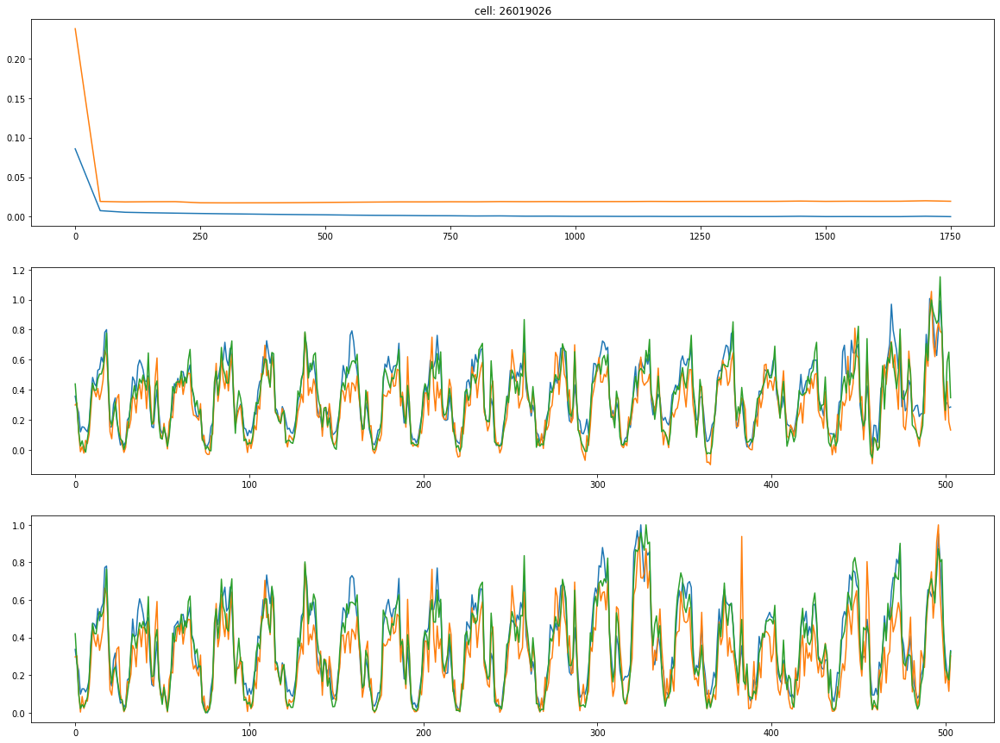

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.329351  1.617373e+10     1.525379  2.601903e+07
std      16.768907  2.070131e+10     1.988874  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       1.678248  7.168926e+08     0.093469  2.601902e+07
50%       8.278663  7.969910e+09     0.768097  2.601903e+07
75%      21.735608  2.450470e+10     2.210700  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:8.798152703093365e-05  test_loss:0.021913813427090645: 100%|██████████| 1800/1800 [00:10<00:00, 164.23it/s]


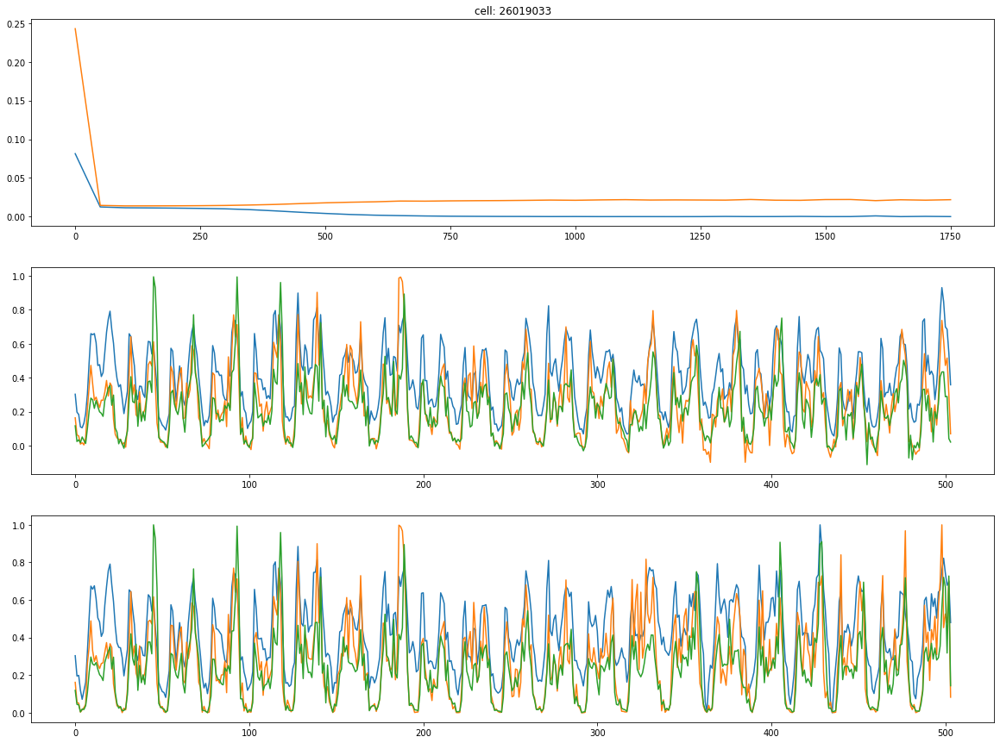

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.436871  1.625381e+10     1.531065  2.601903e+07
std      16.699055  2.065205e+10     1.985252  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       2.010587  9.900665e+08     0.115171  2.601902e+07
50%       8.356180  8.064955e+09     0.772164  2.601903e+07
75%      21.735608  2.450470e+10     2.210700  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0005253565032035112  test_loss:0.021605132147669792: 100%|██████████| 1800/1800 [00:10<00:00, 164.09it/s]


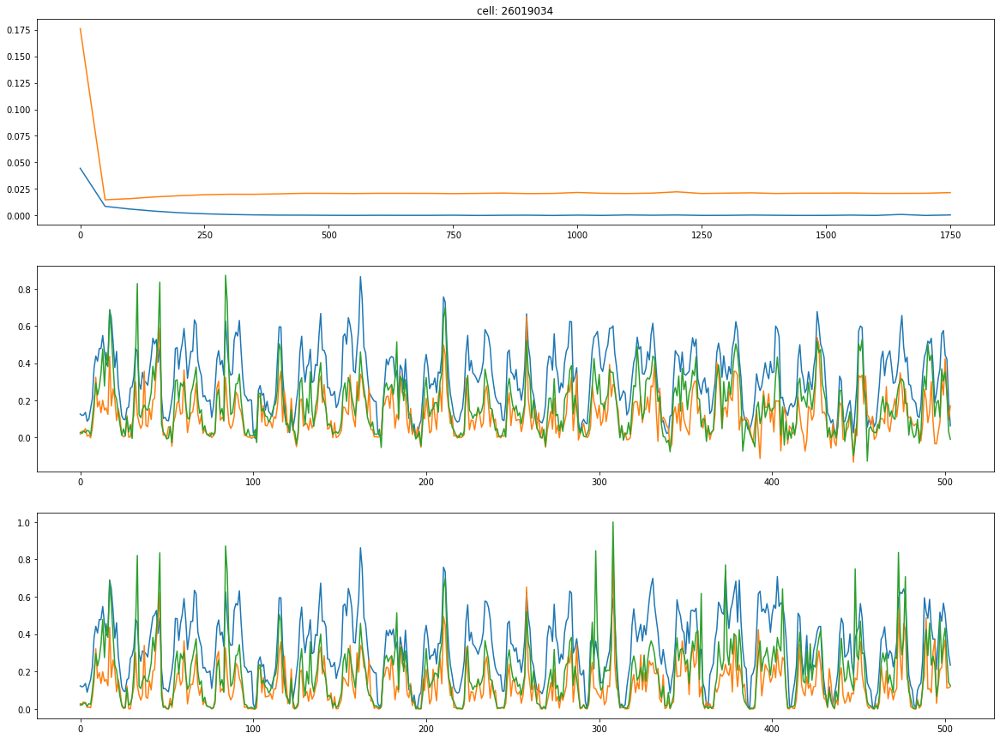

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.463411  1.628647e+10     1.533212  2.601903e+07
std      16.677756  2.062903e+10     1.983707  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       2.117659  1.117986e+09     0.125679  2.601902e+07
50%       8.356180  8.064955e+09     0.772164  2.601903e+07
75%      21.735608  2.450470e+10     2.210700  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:4.2636787839001045e-05  test_loss:0.014518259093165398: 100%|██████████| 1800/1800 [00:11<00:00, 162.25it/s]


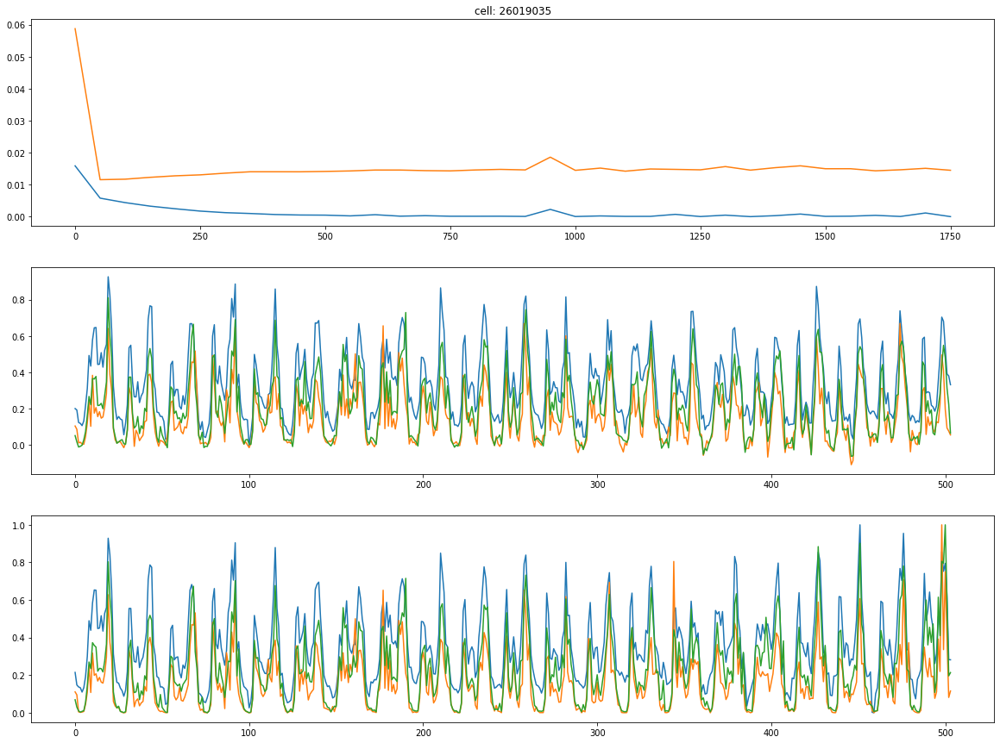

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.514690  1.636312e+10     1.537441  2.601903e+07
std      16.638967  2.058267e+10     1.980874  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       2.320219  1.309201e+09     0.144993  2.601902e+07
50%       8.356180  8.143554e+09     0.772164  2.601903e+07
75%      21.735608  2.450470e+10     2.210700  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:1.166163565358147e-05  test_loss:0.013444175943732262: 100%|██████████| 1800/1800 [00:11<00:00, 163.46it/s]


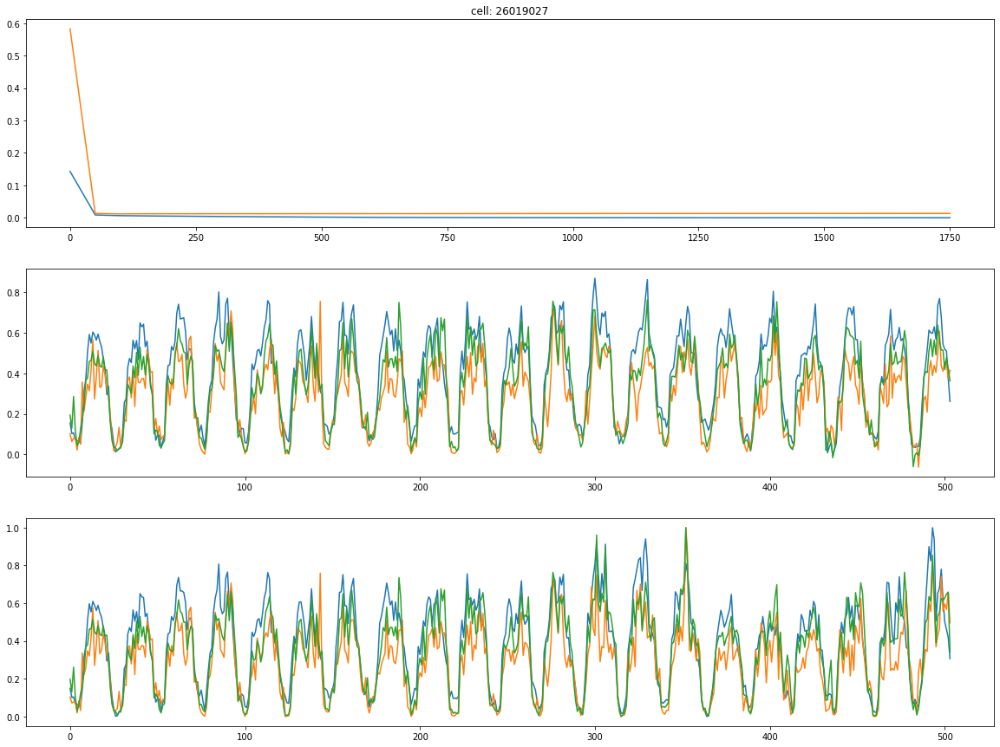

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     14.764972  1.663120e+10     1.564563  2.601903e+07
std      16.547303  2.050539e+10     1.973774  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       2.612875  1.609735e+09     0.170351  2.601902e+07
50%       8.741931  8.523809e+09     0.807229  2.601903e+07
75%      21.976977  2.489018e+10     2.266018  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07


loss:0.0002221717732027173  test_loss:0.009110874496400356: 100%|██████████| 1800/1800 [00:10<00:00, 164.27it/s]


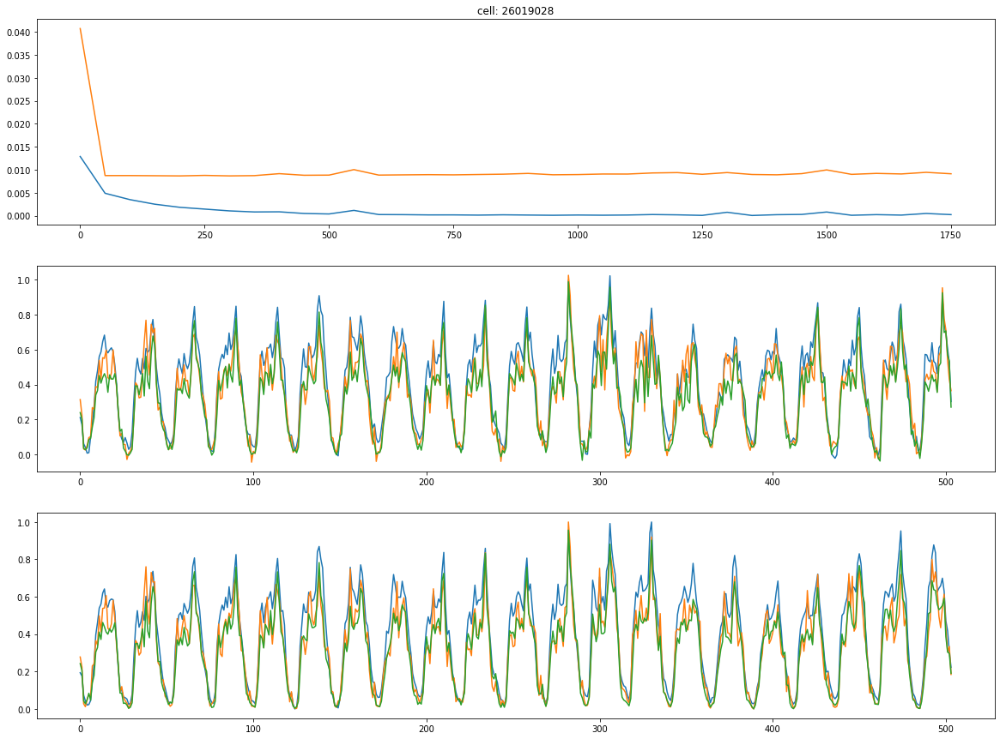

                 1             2            3            xq
count  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean     15.203267  1.711048e+10     1.613034  2.601903e+07
std      16.587298  2.055561e+10     1.982233  1.674267e+01
min       0.000000  0.000000e+00     0.000000  2.601900e+07
25%       2.976712  1.935356e+09     0.194364  2.601902e+07
50%       9.231565  9.031084e+09     0.863697  2.601903e+07
75%      22.674319  2.591229e+10     2.352153  2.601904e+07
max     191.830114  2.151506e+11    21.539210  2.601906e+07
              1             2         3        xq
0     27.530964  3.238965e+10  3.662112  26019014
1     15.076917  1.382425e+10  2.662736  26019015
2     14.992183  2.012710e+10  1.930833  26019016
3      0.651476  0.000000e+00  0.000000  26019023
4      0.708381  2.303520e+05  0.000300  26019024
...         ...           ...       ...       ...
4171   4.800356  7.728544e+06  0.009300  26019033
4172   0.287477  9.376800e+04  0.000100  26019034
4173   1.8

In [11]:
class Net(torch.nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.k = 16
        self.lstm1 = nn.LSTM(3, self.k, num_layers=2, batch_first=True)
        self.sigmod = nn.Sigmoid()
        self.linear2 = nn.Linear(self.k * ipt_size, 3 * opt_size)
    
    def forward(self, ipt):
        x, (h, c) = self.lstm1(ipt)
        x = self.sigmod(x)
        x = x.reshape(-1, self.k * ipt_size)
        x = self.linear2(x)

        return x

from tqdm import tqdm

torch.cuda.empty_cache()

model = Net().to(device)
cost = torch.nn.MSELoss()
# cost = torch.nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


def train_cell(cell, df):
    losses = []

    x_train, y_train, x_test, y_test, pk= make_dataset3(df, 24)

    model.train()
    bar = tqdm(range(1800))
    for i in bar:
        pred = model(x_train)
        loss = cost(pred, y_train)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if i % 50 == 0:
            test_loss = cost(model(x_test), y_test)
            bar.set_description('loss:{}  test_loss:{}'.format(loss.data.float().cpu(), test_loss.data.float().cpu()))
            losses.append([loss.data.float().cpu(), test_loss.data.float().cpu()])
            # print(i, loss, test_loss)

    x, y = make_dataset3(df, test=True)

    model.eval()
    result = list(model(x).data.reshape(-1).cpu())
    result = np.array(result).reshape(-1, 3)

    plt.figure(figsize=(20, 15))
    plt.subplot(311)
    plt.plot(np.array(range(len(losses))).dot(50), losses)
    # ax1.set_ylim(0, 0.1)
    plt.title('cell: {}'.format(cell))

    plt.subplot(312)
    plt.plot(range(result.shape[0]), result)

    plt.subplot(313)
    y = y.cpu().reshape(-1,3)
    plt.plot(range(y.shape[0]), y)

    plt.show()

    k = torch.tensor(pk[696-ipt_size:], dtype=torch.float).reshape(-1, opt_size // 3, 3).to(device)
    ans = model(k).data.cpu()
    return ans.numpy(), model


models3 = {}
cells = df3['小区编号'].unique()
df_ans = pd.DataFrame(columns=[1,2,3, 'xq'])
df_ans['xq'] = np.array([cells for i in range(24*3)]).flatten()
df_ans = df_ans.fillna(0)
for i, cell in enumerate(cells):
    df_ = df3[df3['小区编号']==cell]
    ans, model = train_cell(cell, df_)
    models3[cell] = model
    ans = ans.reshape(-1, 3)
    
    mn = df_[['小区内的平均用户数', 'PDCP_total', '平均激活用户数']].min().to_numpy()
    mx = df_[['小区内的平均用户数', 'PDCP_total', '平均激活用户数']].max().to_numpy()
    ans = np.where(ans > 0, ans, 0)
    ans = mn + ans*(mx - mn)

    for j, data in enumerate(ans):
        df_ans.iloc[i+58*j, :3] = data
    print(df_ans.describe())
print(df_ans)



In [199]:
df_ans.to_csv('./ans.csv')
for cell, model in models3.items():
    torch.save(model, '{}.model'.format(cell))

In [200]:
r1 = df3['小区内的平均用户数'].max() - df3['小区内的平均用户数'].min()
r2 = df3['PDCP_total'].max() - df3['PDCP_total'].min()
r3 = df3['平均激活用户数'].max() - df3['平均激活用户数'].min()
print(df3[['小区内的平均用户数', 'PDCP_total', '平均激活用户数']].describe())
df_k = pd.read_csv('./ans.csv')

print(df_k.describe())

          小区内的平均用户数    PDCP_total       平均激活用户数
count  40368.000000  4.036800e+04  40368.000000
mean      16.289778  1.713338e+10      1.704604
std       18.776924  2.097545e+10      2.079583
min        0.000000  0.000000e+00      0.000000
25%        2.691300  1.770265e+09      0.197400
50%        9.392200  8.385858e+09      0.900150
75%       23.347500  2.570989e+10      2.487125
max      158.459400  1.685522e+11     18.049600
        Unnamed: 0            1             2            3            xq
count  4176.000000  4176.000000  4.176000e+03  4176.000000  4.176000e+03
mean   2087.500000    16.717676  1.953457e+10     1.832893  2.601903e+07
std    1205.651691    18.101123  2.215116e+10     2.135369  1.674267e+01
min       0.000000     0.000000  0.000000e+00     0.000000  2.601900e+07
25%    1043.750000     3.287011  2.633127e+09     0.250911  2.601902e+07
50%    2087.500000    10.684027  1.111906e+10     1.063871  2.601903e+07
75%    3131.250000    24.375923  3.000960e+10     2.78992